### All sky 1:8 cut

In [1]:
import pickle 
import numpy as np
from cube_fil_finder.vis import tree_vis
from cube_fil_finder.vis import node_vis
from cube_fil_finder.util import cube_util
from cube_fil_finder.galfa import galfa_const
from cube_fil_finder.galfa import galfa_util
from matplotlib import pyplot as plt
%matplotlib inline

/Users/larryli/anaconda/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')


In [7]:
reload(cube_util)
reload(tree_vis)
reload(node_vis)
reload(galfa_util)

<module 'cube_fil_finder.galfa.galfa_util' from '/Users/larryli/Documents/CC/16-17/research/3d_filfind/cube_fil_finder/galfa/galfa_util.pyc'>

In [3]:
pickle_path_all_sky_1_8 = '../pickled_dicts/all_sky_1_8_cut/all_sky_1_8.p'
trees_all_sky_1_8 = pickle.load(open(pickle_path_all_sky_1_8, 'rb'))

### Print out tree masks

In [136]:
for k in trees_all_sky_1_8:
    save_dropbox = '/Users/larryli/Dropbox/GALFA_filfind_yes_no_maybe/all_sky_1_8_cut/'
    this_node = trees_all_sky_1_8[k]
    tree_vis.vis_tree_mask_moment(this_node, k, save_fig=True, save_dir=save_dropbox)

/Users/larryli/anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


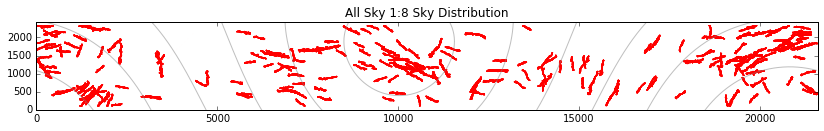

In [6]:
fig1 = tree_vis.vis_trees_sky_dist(trees_all_sky_1_8, 'All Sky 1:8', return_fig=True)
fig1.show()

In [11]:
# color by galactic latitude
color_range = {}
for k in trees_all_sky_1_8:
    node = trees_all_sky_1_8[k].root_node
    node_avg_index = (np.asarray(node.corner_TR) + np.asarray(node.corner_BL)) / 2
    node_xs = node_avg_index[:1]
    node_ys = node_avg_index[1:]
    node_avg_l, node_avg_b = galfa_util.galfa_index_to_lb(node_xs, node_ys)
    color_range[k] = node_avg_b[0]

in div


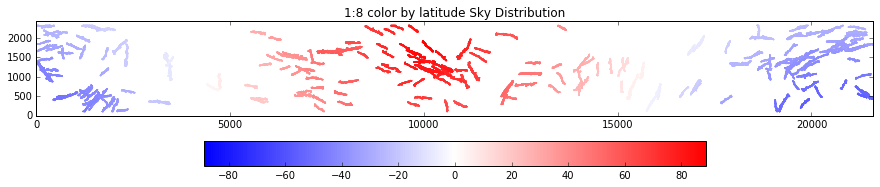

In [15]:
fig3 = tree_vis.vis_trees_sky_dist_color_range(trees_all_sky_1_8, '1:8 color by latitude',
                                               color_range, 'bwr', return_fig=True)
fig3.show()

In [7]:
div_cmaps = set(['PiYG', 'PRGn', 'BrBG', 'PuOr', 'RdGy', 'RdBu', 'RdYlBu',
                     'RdYlGn', 'Spectral', 'coolwarm', 'bwr', 'seismic'])

### WIDTH dist

In [7]:
import glob
from astropy.io import fits
import filfind_class as filfind

def create_0th_moment_map(cube):
    moment_map = np.zeros_like(cube[0])
    for s in cube:
        moment_map = np.add(moment_map, s)
    
    return moment_map

DATA_SLICE_BASE_DIR = '/Volumes/LarryExternal1/Research_2017/GALFA_slices_backup/umask_gaussian_30/'

widths_fits_1_8 = {}
for key in trees_all_sky_1_8:
    this_node = trees_all_sky_1_8[key]
    slice_files_list = []
    for i in range(this_node.length):
        slice_file_name = glob.glob(DATA_SLICE_BASE_DIR + '*{0}*'.format(str(this_node.root_v_slice + i)))[0]
        slice_files_list.append(slice_file_name)

    this_structure_cube = []
    for f in slice_files_list:
        full_slice, hdr = fits.getdata(f, header=True)
        corners = this_node.root_node.corners
        structure_slice = full_slice[corners[0][1]:corners[1][1], corners[0][0]:corners[1][0]]
        this_structure_cube.append(structure_slice)

    this_moment_map = create_0th_moment_map(this_structure_cube)

    fils = filfind.fil_finder_2D(this_moment_map, header=hdr, beamwidth=10.0, glob_thresh=20,
                                 distance=100, flatten_thresh=95, standard_width=0.5,
                                 size_thresh=600, mask=this_node.root_node.mask)
    fils.medskel()
    fils.analyze_skeletons(skel_thresh=1000.0, branch_thresh=50)
    fils.exec_rht()
    fils.find_widths(verbose=False, try_nonparam=False, auto_cut=False, max_distance=0.6)
    
    if fils.number_of_filaments == 1:
        widths_fits_1_8[key] = fils.width_fits["Parameters"][0, :]
    else:
        main_filament_index = np.argmax(fils.lengths)
        widths_fits_1_8[key] = fils.width_fits['Parameters'][main_filament_index, :]

Optional package aplpy could not be imported.


/Users/larryli/Documents/CC/16-17/research/3d_filfind/fil_finder/filfind_class.py:1204: RuntimeWarning: invalid value encountered in less_equal
  within_width = np.where(unbin_dist <= fit[1])
/Users/larryli/Documents/CC/16-17/research/3d_filfind/fil_finder/width.py:167: RuntimeWarning: invalid value encountered in sqrt
  fit_errors = np.sqrt(np.diag(cov))
/Users/larryli/Documents/CC/16-17/research/3d_filfind/fil_finder/width.py:190: RuntimeWarning: invalid value encountered in greater
  if fit_errors is None or fit[0] < fit[2] or (fit_errors > fit).any():


In [8]:
len(widths_fits_1_8)

233

In [9]:
fwhm_fits_1_8 = {}
for k in widths_fits_1_8:
    if not np.isnan(widths_fits_1_8[k][0]):
        fwhm_fits_1_8[k] = widths_fits_1_8[k][1] * 2
    else:
        fwhm_fits_1_8[k] = None

In [10]:
pickle.dump(fwhm_fits_1_8, open('fwhm_fits_1_8.p', 'wb'))

In [8]:
fwhm_fits_1_8 = pickle.load(open('fwhm_fits_1_8.p', 'rb'))

In [18]:
# note look at ex = trees_all_sky_1_8['5133_972_0']

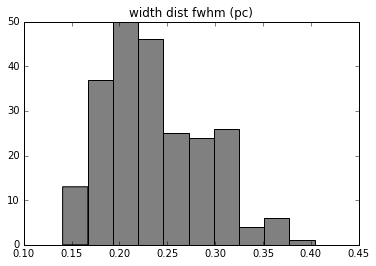

Median = 0.228357641652, sigma = 0.0514689537363


In [9]:
fwhms = [v for v in fwhm_fits_1_8.values() if v is not None]
plt.hist(fwhms, color='gray')
plt.title('width dist fwhm (pc)')
plt.show()
print('Median = {0}, sigma = {1}'.format(np.median(fwhms), np.std(fwhms)))

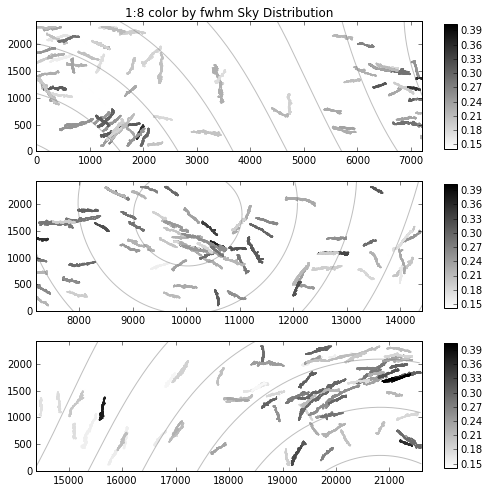

In [10]:
fig4 = tree_vis.vis_trees_sky_dist_color_range_3_panels(trees_all_sky_1_8, '1:8 color by fwhm',
                                                        fwhm_fits_1_8, 'binary', save_fig=False,
                                                        return_fig=True)
                                                        #save_dir='../vis/all_sky_maps/',
                                                        #save_name='1_8_color_width.pdf',

In [84]:
fig4.savefig('../vis/all_sky_maps/1_8_color_width.pdf')

### mid velocity dist

In [85]:
mid_v = {}
for k in trees_all_sky_1_8:
    this_tree = trees_all_sky_1_8[k]
    mid_v[k] = this_tree.root_v_slice + this_tree.length / 2.

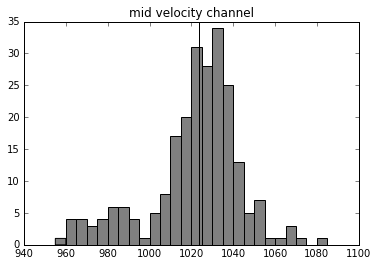

In [86]:
plt.hist(mid_v.values(), range(955, 1095, 5), color='gray')
plt.plot([1023.5, 1023.5], [0,35], color='black')
plt.title('mid velocity channel')
plt.show()

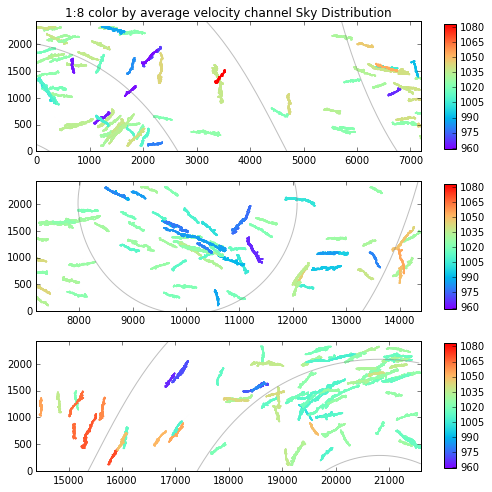

In [87]:
reload(tree_vis)
fig5 = tree_vis.vis_trees_sky_dist_color_range_3_panels(trees_all_sky_1_8, 
                                                        '1:8 color by average velocity channel',
                                                        mid_v, 'rainbow', return_fig=True)
fig5.show()

In [88]:
fig5.savefig('../vis/all_sky_maps/1_8_color_mid_v.pdf')

### velocity span dist

In [89]:
v_span = {}
for k in trees_all_sky_1_8:
    this_tree = trees_all_sky_1_8[k]
    v_span[k] = this_tree.length

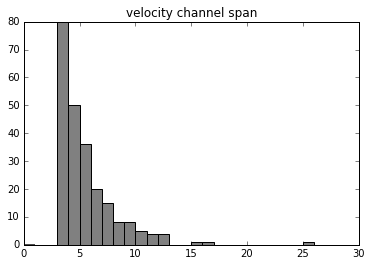

In [90]:
plt.hist(v_span.values(), range(0,30,1), color='gray')
plt.title('velocity channel span')
plt.show()

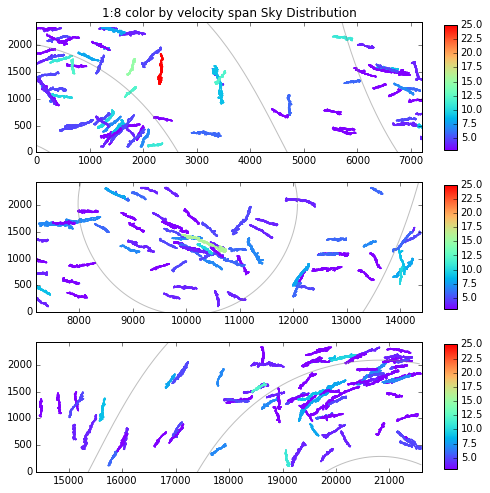

In [91]:
fig6 = tree_vis.vis_trees_sky_dist_color_range_3_panels(trees_all_sky_1_8, '1:8 color by velocity span',
                                               v_span, 'rainbow', return_fig=True)

In [92]:
fig6.savefig('../vis/all_sky_maps/1_8_color_v_span.pdf')
fig6.show()

### position and name on sky

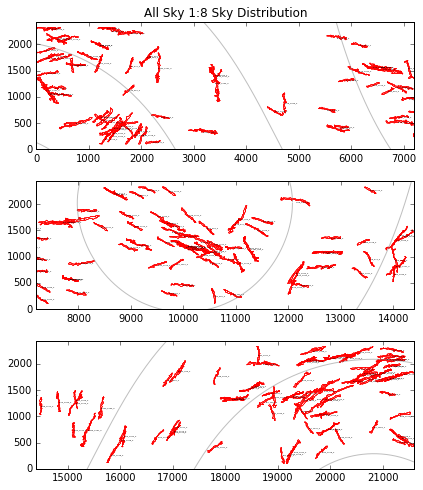

In [100]:
reload(tree_vis)
fig7 = tree_vis.vis_trees_sky_dist_names_3_panels(trees_all_sky_1_8, 'All Sky 1:8', return_fig=True)
fig7.show()

In [101]:
fig7.savefig('../vis/all_sky_maps/1_8_names.pdf')

### width maps

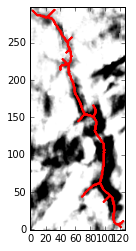

0 in 1
Fit Parameters: [ 8.42586447  0.12635636  1.44645276  0.27069258] 
Fit Errors: [ 0.10776187  0.00677889  0.103009    0.01754667]
Fit Type: gaussian


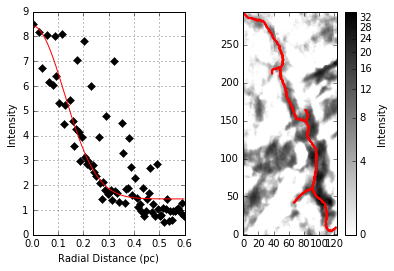

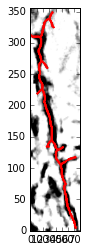

0 in 2
Fit Parameters: [ 7.6453539   0.07028331  1.23882016  0.1101468 ] 
Fit Errors: [ 0.13115904  0.00601592  0.08051554  0.02128618]
Fit Type: gaussian


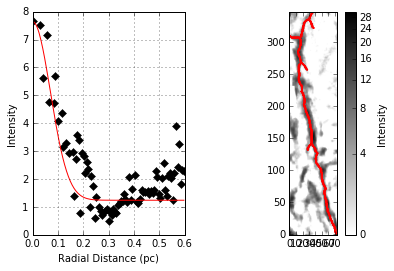

1 in 2
Fit Parameters: [ 5.21078192  0.0731362   0.17751699  0.12000493] 
Fit Errors: [ 0.10214744  0.00746679  0.39198463  0.02523379]
Fit Type: gaussian


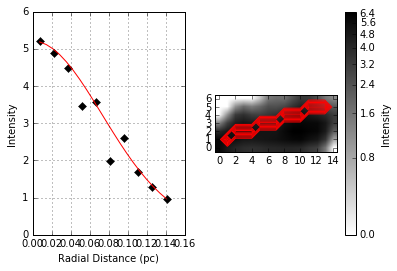

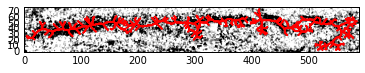

0 in 2
Fit Parameters: [ 0.43892836  0.15635007  0.10536094  0.34683474] 
Fit Errors: [ 0.00499976  0.00633631  0.00519543  0.01583899]
Fit Type: gaussian


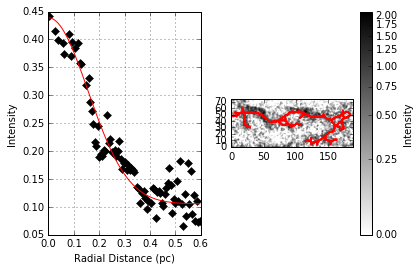

1 in 2
Fit Parameters: [ 0.55562866  0.16627097  0.16586373  0.37154103] 
Fit Errors: [ 0.00421925  0.0057124   0.00577215  0.01417567]
Fit Type: gaussian


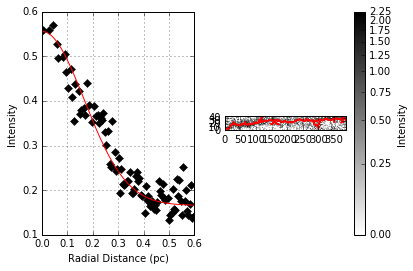

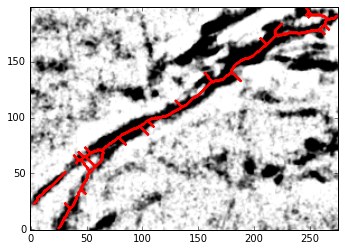

0 in 2
Fit Parameters: [ 3.13101771  0.11820117  0.4517237   0.24942954] 
Fit Errors: [ 0.03102652  0.00458829  0.03706396  0.01205703]
Fit Type: gaussian


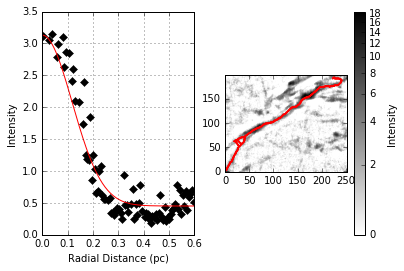

1 in 2
Fit Parameters: [ 3.6271195   0.05687817  0.16223947  0.05176783] 
Fit Errors: [ 0.01564252  0.00137833  0.00898641  0.0083976 ]
Fit Type: gaussian


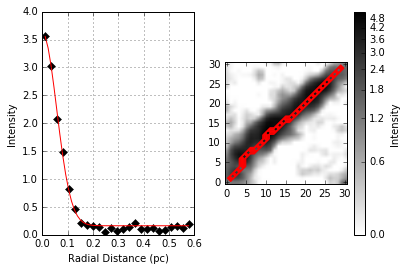

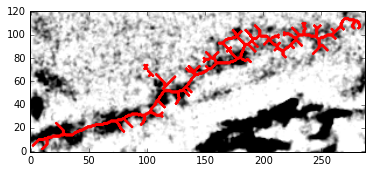

0 in 1
Fit Parameters: [ 1.10350853  0.14720779  0.2158404   0.32389087] 
Fit Errors: [ 0.00568262  0.00349526  0.00897206  0.008809  ]
Fit Type: gaussian


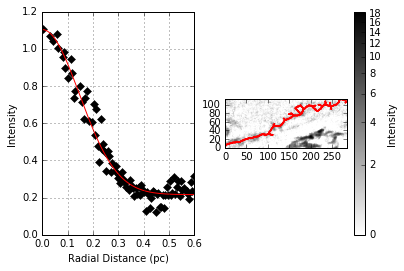

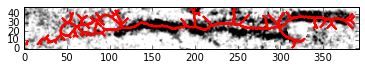

0 in 1
Fit Parameters: [ 1.28203505  0.09641907  0.44426097  0.19050476] 
Fit Errors: [ 0.02915279  0.01381486  0.01773694  0.03877207]
Fit Type: gaussian


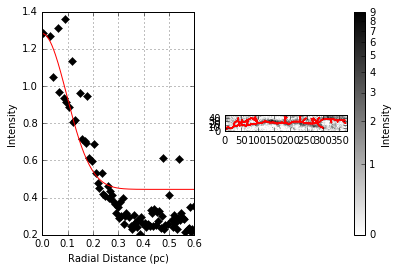

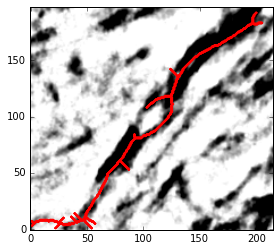

0 in 1
Fit Parameters: [ 5.9083063   0.12102991  0.94020186  0.25684168] 
Fit Errors: [ 0.05516675  0.00518486  0.08687244  0.01354815]
Fit Type: gaussian


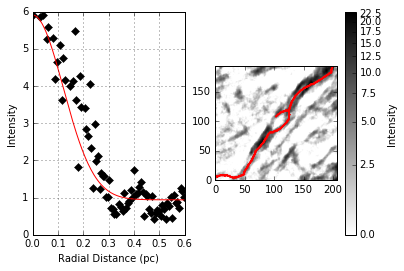

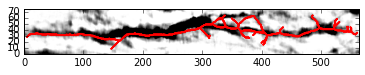

0 in 1
Fit Parameters: [ 16.26939537   0.10997895   1.79633672   0.22762146] 
Fit Errors: [ 0.14107548  0.0041325   0.1114438   0.01107195]
Fit Type: gaussian


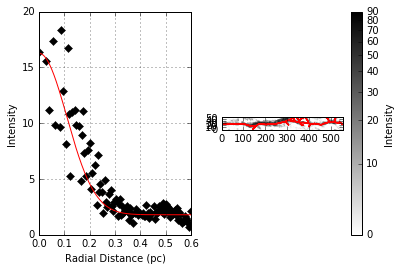

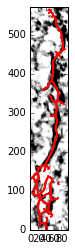

0 in 1
Fit Parameters: [ 16.25361855   0.1031833    3.936926     0.20923414] 
Fit Errors: [ 0.07743579  0.00357599  0.12006146  0.00977886]
Fit Type: gaussian


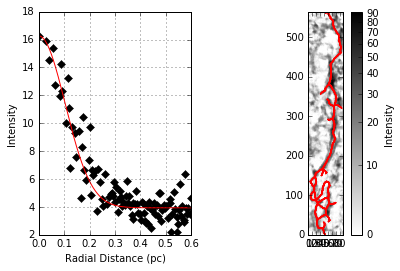

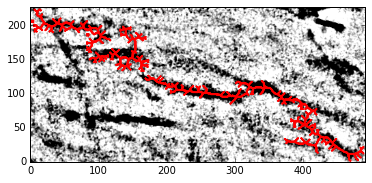

0 in 4
Fit Parameters: [ 0.97695867  0.11007434  0.13947841  0.22787701] 
Fit Errors: [ 0.00319996  0.0021008   0.0043372   0.0056271 ]
Fit Type: gaussian


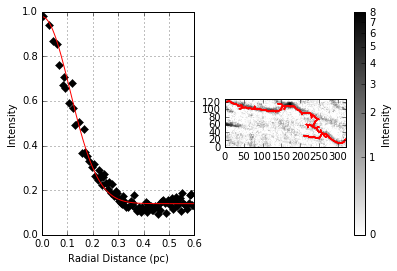

1 in 4
Fit Parameters: [ 0.48835288  0.0659939   0.32113741  0.09429152] 
Fit Errors: [ 0.13254014  0.20617684  0.02542461  0.80017779]
Fit Type: gaussian


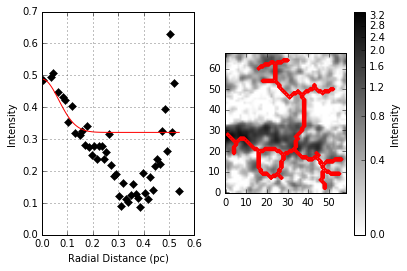

2 in 4
Fit Parameters: [ 0.89479296  0.2071257  -0.50425171  0.47184164] 
Fit Errors: [ 0.0272002   0.04267548  0.35842951  0.10387992]
Fit Type: gaussian


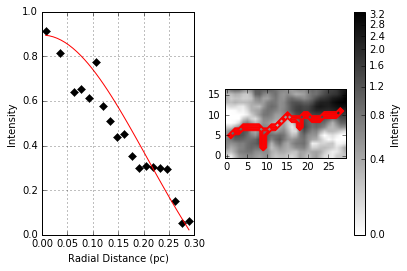

3 in 4
Fit Parameters: [ 0.5156884   0.09695607  0.2020713   0.19201012] 
Fit Errors: [ 0.00856211  0.008028    0.01000543  0.02247884]
Fit Type: gaussian


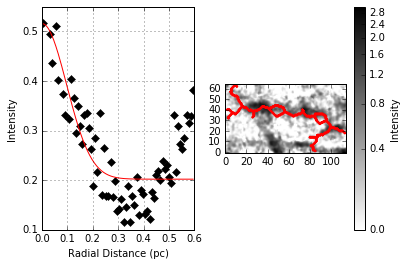

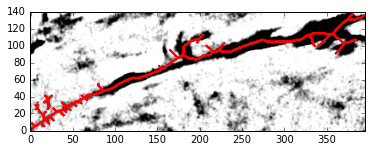

0 in 2
Fit Parameters: [ 4.49938574  0.09135136  0.2835857   0.17611208] 
Fit Errors: [ 0.04958337  0.00405586  0.03097808  0.01166607]
Fit Type: gaussian


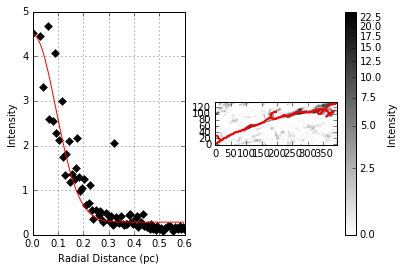

1 in 2
Fit Parameters: [ 1.05380108  0.02513227  0.49183059  0.        ] 
Fit Errors: [ 0.03745054  0.00549429  0.04233984  0.        ]
Fit Type: gaussian


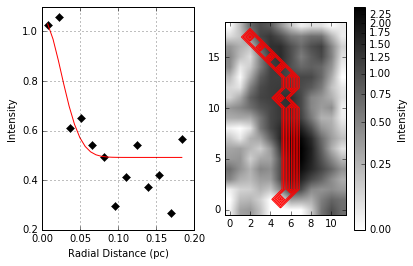

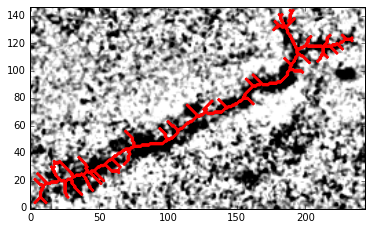

0 in 1
Fit Parameters: [ 0.63596543  0.1158841   0.13218033  0.2433258 ] 
Fit Errors: [ 0.00308001  0.00298526  0.00505802  0.00788376]
Fit Type: gaussian


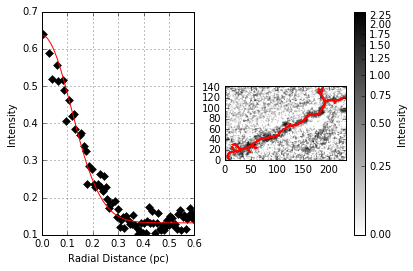

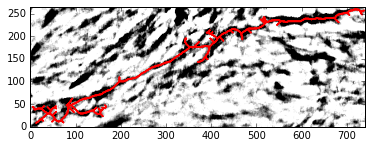

0 in 1
Fit Parameters: [ 5.37111943  0.15582102  1.30221959  0.34551198] 
Fit Errors: [ 0.02772063  0.00495425  0.04476557  0.01238957]
Fit Type: gaussian


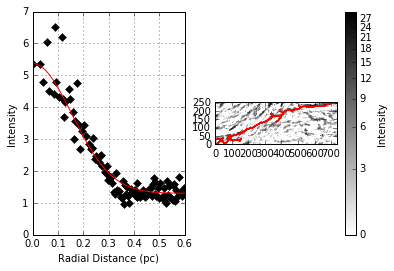

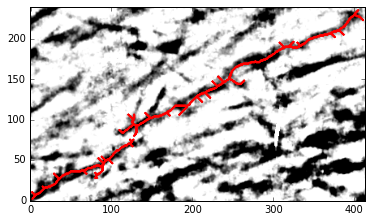

0 in 2
Fit Parameters: [ 3.53839183  0.11797618  0.68277735  0.24883818] 
Fit Errors: [ 0.02804105  0.00495677  0.04826357  0.0130314 ]
Fit Type: gaussian


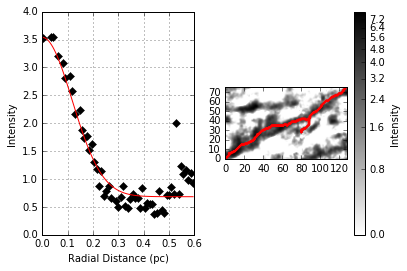

1 in 2
Fit Parameters: [ 2.76605989  0.12749102  0.35497193  0.27362684] 
Fit Errors: [ 0.01828287  0.00346328  0.0125695   0.00894797]
Fit Type: gaussian


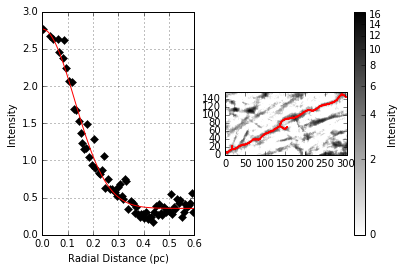

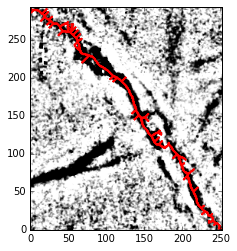

0 in 2
Fit Parameters: [ 2.11457917  0.07209095  0.15514469  0.11644498] 
Fit Errors: [ 0.01227812  0.00203742  0.01723263  0.00699448]
Fit Type: gaussian


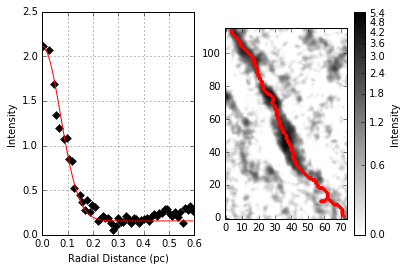

1 in 2
Fit Parameters: [ 1.67643611  0.09122329  0.35942432  0.17574357] 
Fit Errors: [ 0.01734841  0.00391407  0.02232703  0.01126601]
Fit Type: gaussian


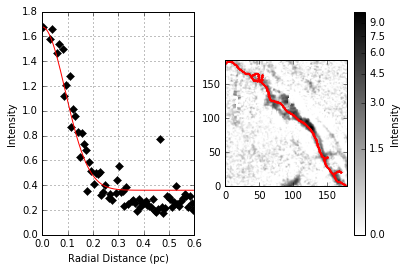

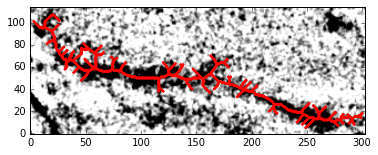

0 in 1
Fit Parameters: [ 0.86201797  0.10619376  0.18795803  0.21742624] 
Fit Errors: [ 0.00540845  0.0036763   0.0081704   0.00995667]
Fit Type: gaussian


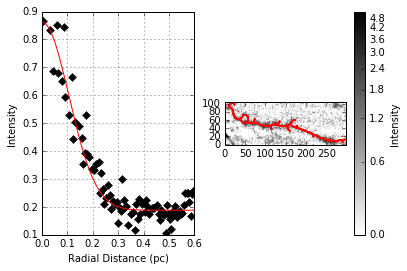

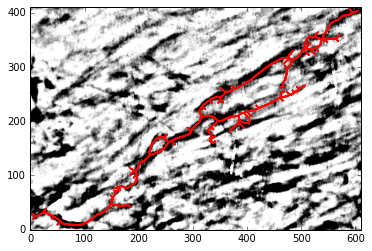

0 in 1
Fit Parameters: [ 7.0452658   0.14049544  1.38522192  0.30691471] 
Fit Errors: [ 0.01360145  0.00213494  0.0295434   0.00541933]
Fit Type: gaussian


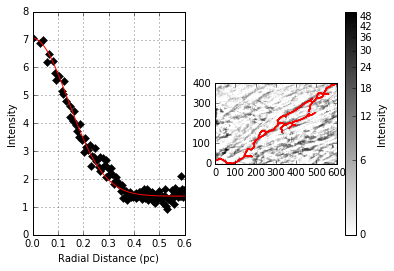

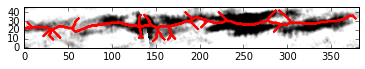

0 in 1
Fit Parameters: [ 2.97644764  0.13593463  0.33492286  0.29530593] 
Fit Errors: [ 0.05926369  0.00797233  0.02007384  0.02034973]
Fit Type: gaussian


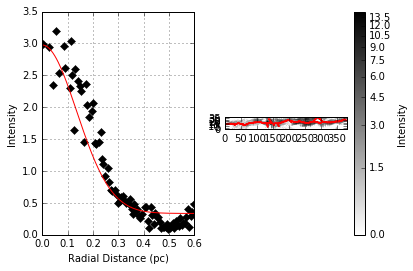

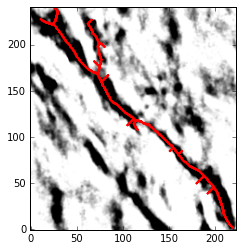

0 in 1
Fit Parameters: [ 9.5938013   0.11640083  0.90968774  0.24468965] 
Fit Errors: [ 0.08068179  0.00283191  0.06983409  0.00747026]
Fit Type: gaussian


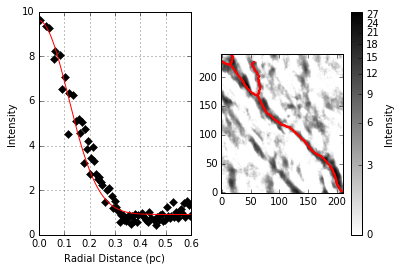

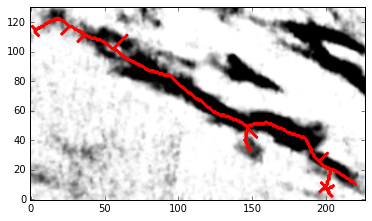

0 in 1
Fit Parameters: [ 6.52916603  0.15677495  0.13402376  0.34789663] 
Fit Errors: [ 0.03177669  0.00259978  0.05481393  0.00649648]
Fit Type: gaussian


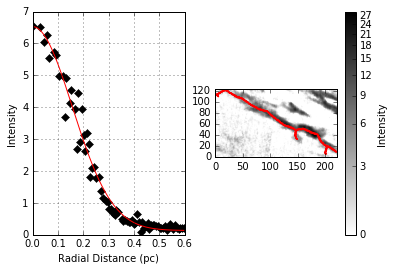

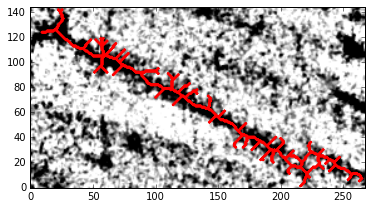

0 in 1
Fit Parameters: [ 0.60483813  0.10544595  0.1057686   0.21539859] 
Fit Errors: [ 0.00288345  0.00210325  0.00424318  0.00570945]
Fit Type: gaussian


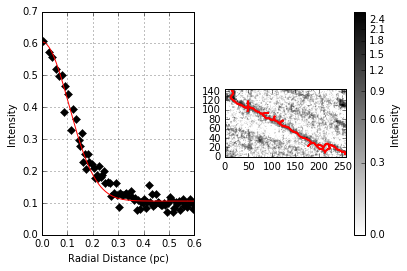

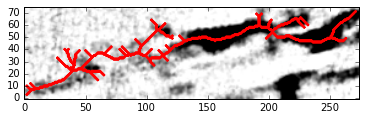

0 in 1
Fit Parameters: [ 2.55798124  0.1501619   0.23014676  0.3313254 ] 
Fit Errors: [ 0.01261873  0.00316935  0.02172101  0.00796509]
Fit Type: gaussian


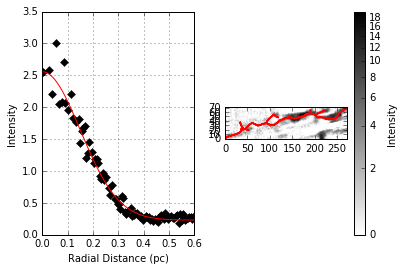

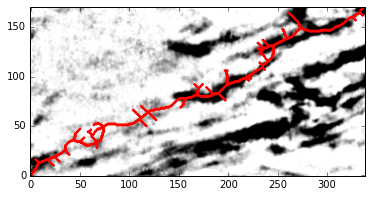

0 in 1
Fit Parameters: [ 3.41587322  0.09735413  0.64831546  0.19312376] 
Fit Errors: [ 0.02330529  0.00362354  0.02775107  0.01012901]
Fit Type: gaussian


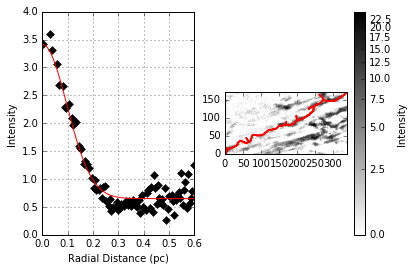

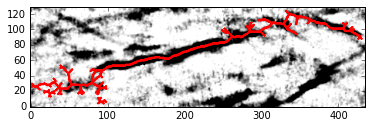

0 in 3
Fit Parameters: [ 0.82316183  0.04283386  0.08566549  0.        ] 
Fit Errors: [ 0.00566576  0.00225948  0.02535371  0.        ]
Fit Type: gaussian


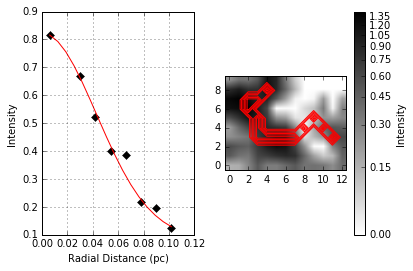

1 in 3
Fit Parameters: [ 0.28525783  0.06827517  0.18447055  0.10290483] 
Fit Errors: [ 0.12701537  0.2141269   0.10001287  0.78779596]
Fit Type: gaussian


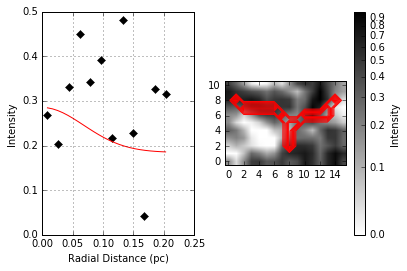

2 in 3
Fit Parameters: [ 3.19248289  0.08458727  0.47155316  0.1562573 ] 
Fit Errors: [ 0.02229739  0.00345214  0.02594324  0.0103626 ]
Fit Type: gaussian


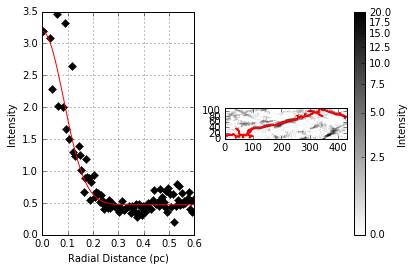

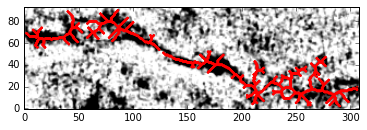

0 in 3
Fit Parameters: [ 0.62338106  0.13480423  0.18674754  0.29241841] 
Fit Errors: [ 0.00821024  0.0069008   0.00810423  0.01764062]
Fit Type: gaussian


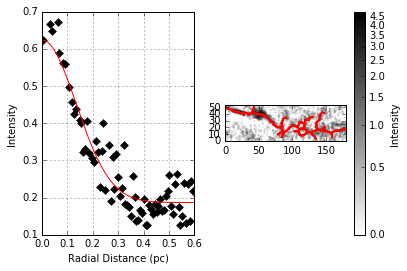

1 in 3
Fit Parameters: [ 0.78235873  0.16741645  0.09682705  0.37438254] 
Fit Errors: [ 0.0089857   0.00907099  0.01143352  0.02249326]
Fit Type: gaussian


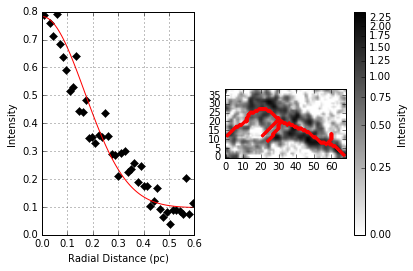

2 in 3
Fit Parameters: [ 1.27914496  0.04836695  0.35548136  0.        ] 
Fit Errors: [ 0.02686485  0.00464557  0.03090047  0.        ]
Fit Type: gaussian


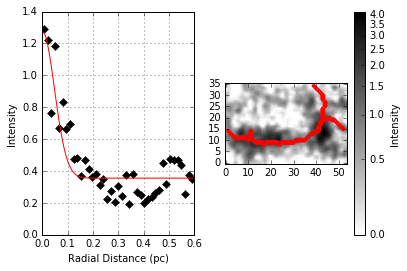

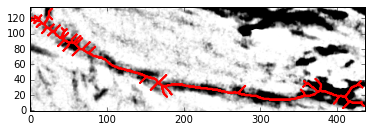

0 in 1
Fit Parameters: [ 3.51182907  0.12752646  0.22016876  0.27371841] 
Fit Errors: [ 0.01596995  0.00269738  0.01849075  0.00696873]
Fit Type: gaussian


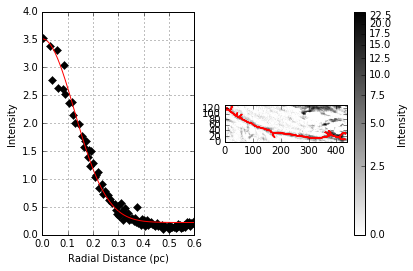

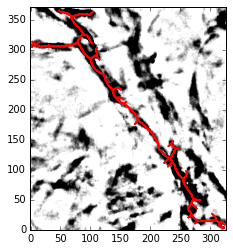

0 in 1
Fit Parameters: [ 7.64776505  0.10381243  1.38131101  0.21095272] 
Fit Errors: [ 0.04399329  0.00319252  0.04169927  0.00871192]
Fit Type: gaussian


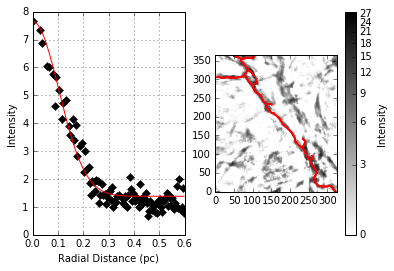

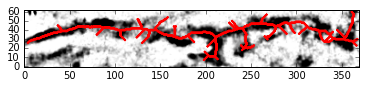

0 in 1
Fit Parameters: [ 2.86859047  0.12785529  0.24316857  0.27456773] 
Fit Errors: [ 0.01198124  0.00220545  0.01660477  0.00569485]
Fit Type: gaussian


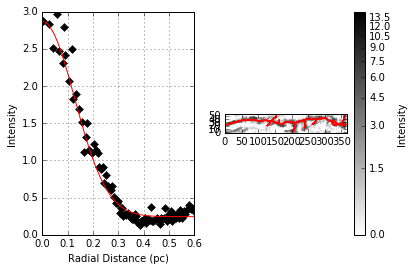

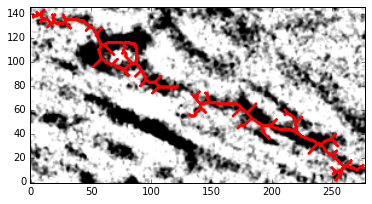

0 in 2
Fit Parameters: [ 0.76778116  0.14297286  0.13454496  0.31319461] 
Fit Errors: [ 0.00574592  0.00464825  0.00905036  0.01176642]
Fit Type: gaussian


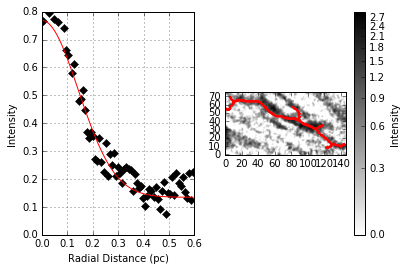

1 in 2
Fit Parameters: [ 0.72386125  0.18508368  0.27823095  0.4179665 ] 
Fit Errors: [ 0.01891085  0.02438753  0.04262358  0.05988388]
Fit Type: gaussian


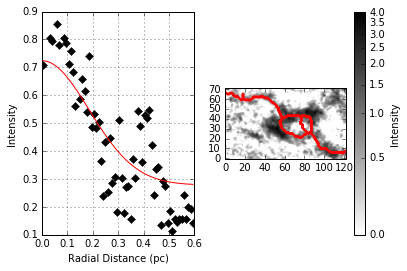

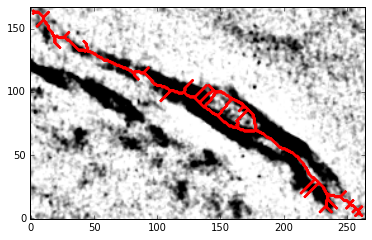

0 in 1
Fit Parameters: [ 1.68552226  0.16147822  0.14683186  0.35962794] 
Fit Errors: [ 0.01470502  0.00528675  0.02467167  0.0131633 ]
Fit Type: gaussian


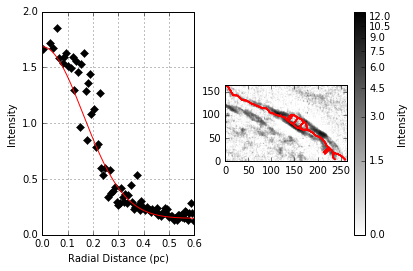

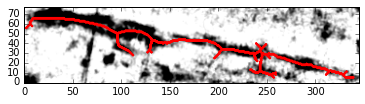

0 in 1
Fit Parameters: [ 2.33903623  0.09054109  0.41163302  0.17377629] 
Fit Errors: [ 0.02615725  0.00497649  0.01762759  0.01437783]
Fit Type: gaussian


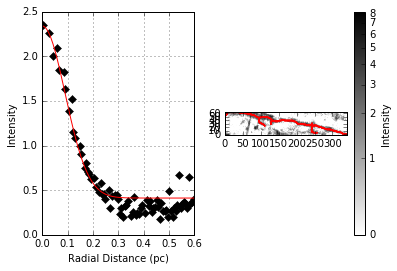

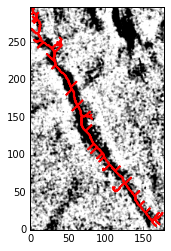

0 in 1
Fit Parameters: [ 1.60734391  0.10209696  0.22367816  0.2062579 ] 
Fit Errors: [ 0.00613439  0.00193797  0.00971313  0.00531944]
Fit Type: gaussian


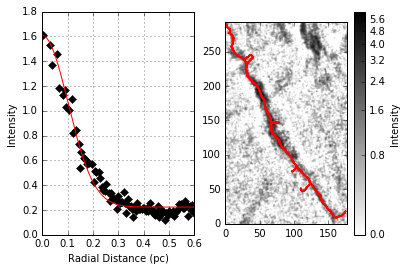

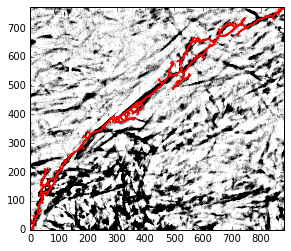

0 in 1
Fit Parameters: [ 5.65682225  0.14810458  0.53422855  0.32615004] 
Fit Errors: [ 0.00910852  0.00153787  0.0203691   0.00387245]
Fit Type: gaussian


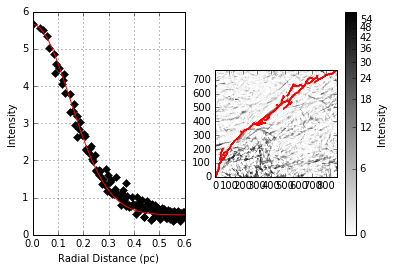

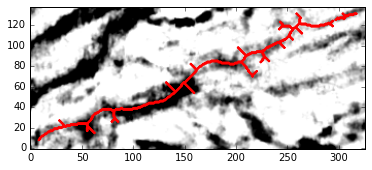

0 in 2
Fit Parameters: [ 2.69576589  0.1182541   0.69244217  0.24956863] 
Fit Errors: [ 0.03058656  0.00741748  0.03823467  0.01948939]
Fit Type: gaussian


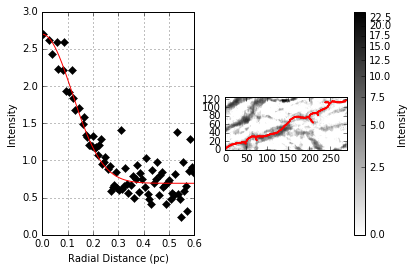

1 in 2
Fit Parameters: [ 2.44718292  0.04528654  0.09027405  0.        ] 
Fit Errors: [ 0.06991816  0.00376357  0.02651864  0.        ]
Fit Type: gaussian


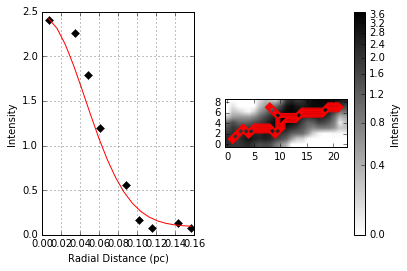

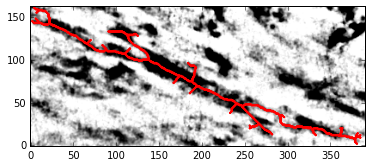

0 in 1
Fit Parameters: [ 3.43107868  0.10286469  0.5490562   0.20836239] 
Fit Errors: [ 0.01495517  0.00263633  0.01956185  0.0072171 ]
Fit Type: gaussian


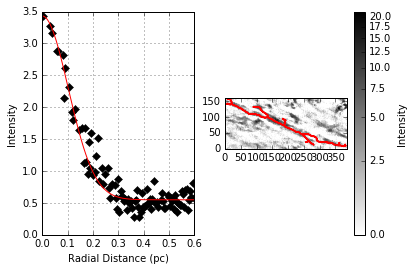

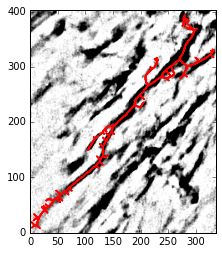

0 in 3
Fit Parameters: [ 7.62757725  0.09512051  0.48957353  0.18684978] 
Fit Errors: [ 0.04420598  0.00295757  0.04757274  0.00834897]
Fit Type: gaussian


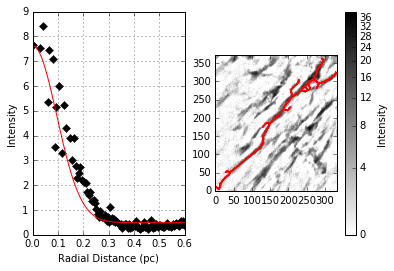

1 in 3
Fit Parameters: [ 11.34223419   0.07366459   0.17193264   0.12178386] 
Fit Errors: [ 0.06969328  0.0023928   0.09241492  0.00802584]
Fit Type: gaussian


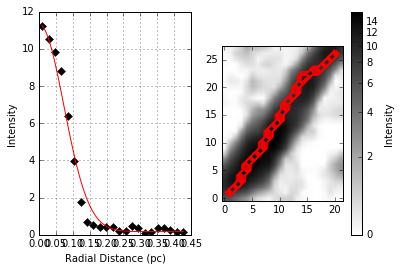

2 in 3
Fit Parameters: [ 5.48923374  0.06261441  4.25267411  0.08050332] 
Fit Errors: [ 0.17321868  0.03152554  0.21985525  0.13596856]
Fit Type: gaussian


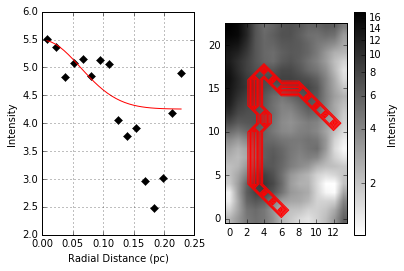

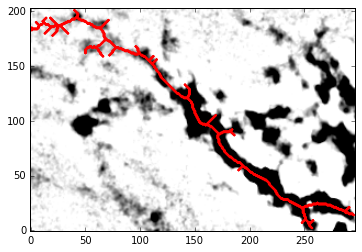

0 in 1
Fit Parameters: [ 6.04926649  0.09173405  0.41061132  0.17721168] 
Fit Errors: [ 0.03810481  0.00252705  0.0290513   0.00725384]
Fit Type: gaussian


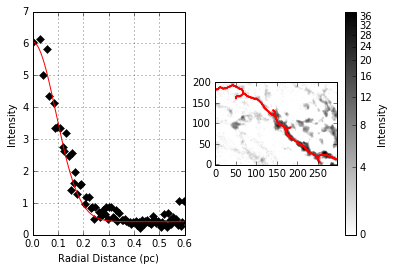

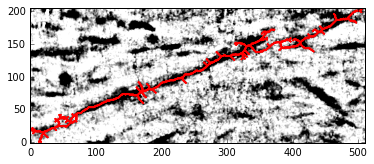

0 in 1
Fit Parameters: [ 1.74594026  0.10471262  0.26931995  0.2134056 ] 
Fit Errors: [ 0.00390217  0.00155474  0.00548716  0.00423025]
Fit Type: gaussian


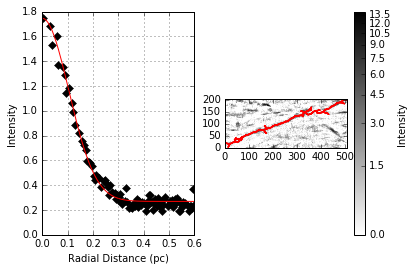

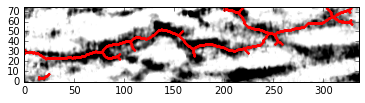

0 in 2
Fit Parameters: [ 2.25733866  0.03576599  1.06566193  0.        ] 
Fit Errors: [ 0.04273069  0.01157176  0.12085628  0.        ]
Fit Type: gaussian


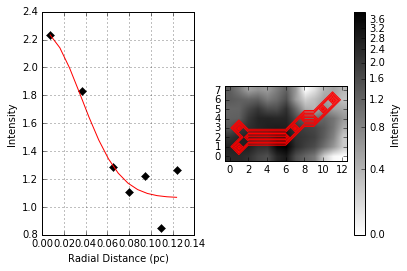

1 in 2
Fit Parameters: [ 3.36653464  0.1168202   0.66712627  0.2457954 ] 
Fit Errors: [ 0.02742725  0.00375503  0.02102375  0.0098963 ]
Fit Type: gaussian


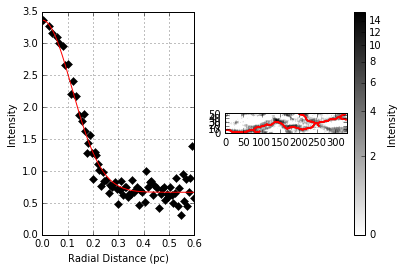

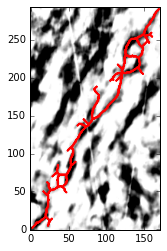

0 in 1
Fit Parameters: [ 17.81579497   0.08010214   3.13668915   0.14254955] 
Fit Errors: [ 0.24064528  0.00433175  0.16995523  0.01349762]
Fit Type: gaussian


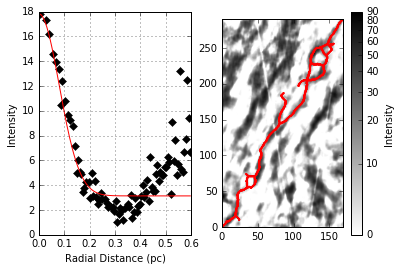

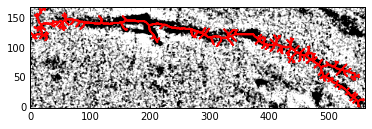

0 in 2
Fit Parameters: [ 0.90804416  0.11510925  0.18310162  0.24127773] 
Fit Errors: [ 0.0026719   0.002214    0.00397786  0.00585715]
Fit Type: gaussian


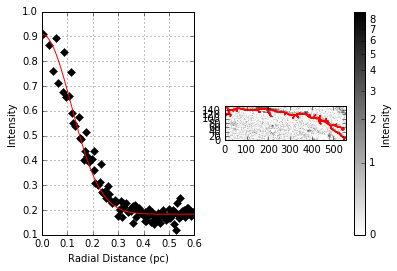

1 in 2
Fit Parameters: [ 0.36989759  0.03241984  0.19078474  0.        ] 
Fit Errors: [ 0.03049841  0.0239795   0.01466848  0.        ]
Fit Type: gaussian


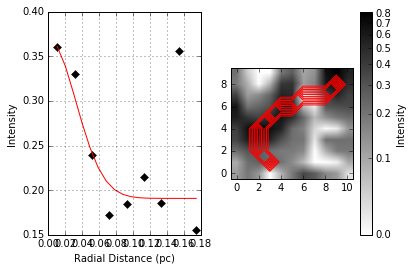

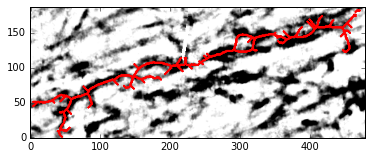

0 in 1
Fit Parameters: [ 5.02128775  0.1208195   1.04990426  0.25629176] 
Fit Errors: [ 0.02942552  0.0035419   0.03121547  0.00925878]
Fit Type: gaussian


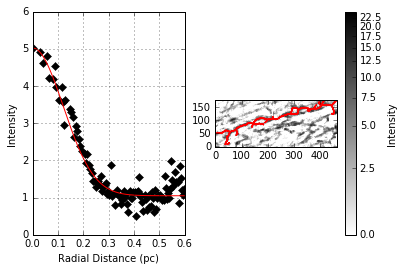

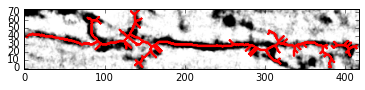

0 in 2
Fit Parameters: [ 3.30519035  0.09081964  0.4021787   0.17458044] 
Fit Errors: [ 0.01934192  0.00223115  0.01919716  0.00643619]
Fit Type: gaussian


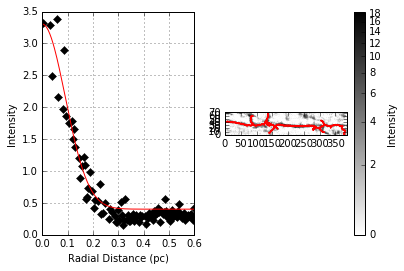

1 in 2
Fit Parameters: [ 5.12518378  0.08704286  1.09799315  0.16356459] 
Fit Errors: [ 0.2274066   0.01762296  0.12140494  0.05200417]
Fit Type: gaussian


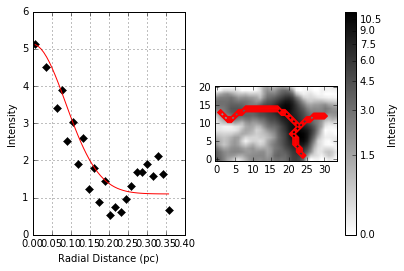

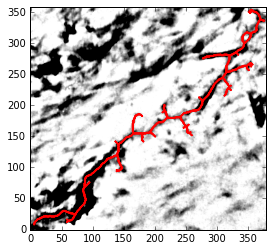

0 in 1
Fit Parameters: [ 9.46401092  0.10022356  1.36036567  0.20109836] 
Fit Errors: [ 0.04974113  0.00324791  0.06484722  0.00897595]
Fit Type: gaussian


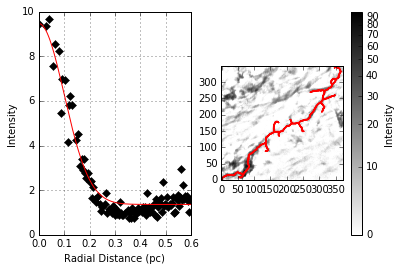

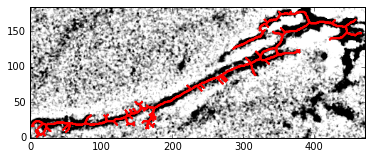

0 in 1
Fit Parameters: [ 1.9796331   0.0844701   0.22709472  0.15590543] 
Fit Errors: [ 0.01029682  0.00222725  0.00734363  0.00669155]
Fit Type: gaussian


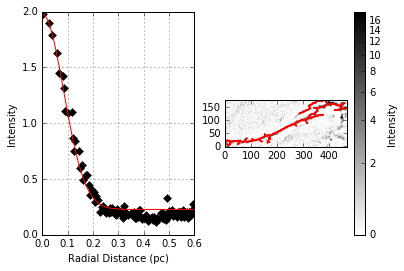

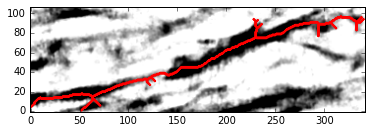

0 in 1
Fit Parameters: [ 7.66688806  0.12510938  0.72553544  0.26746152] 
Fit Errors: [ 0.0546453   0.00313059  0.06207681  0.00812028]
Fit Type: gaussian


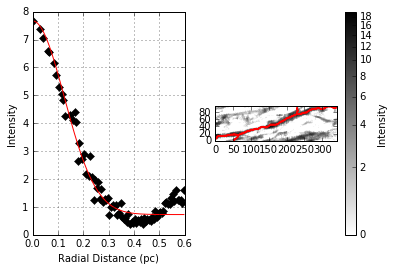

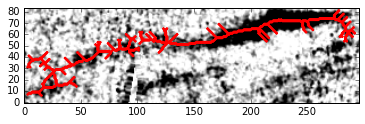

0 in 2
Fit Parameters: [ 0.77899847  0.09692659  0.22383245  0.19192758] 
Fit Errors: [ 0.00568034  0.00351398  0.00691696  0.00984057]
Fit Type: gaussian


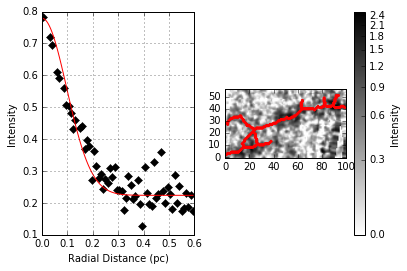

1 in 2
Fit Parameters: [ 1.61105177  0.11072716  0.28770372  0.22962412] 
Fit Errors: [ 0.01297579  0.00345332  0.01606209  0.00923399]
Fit Type: gaussian


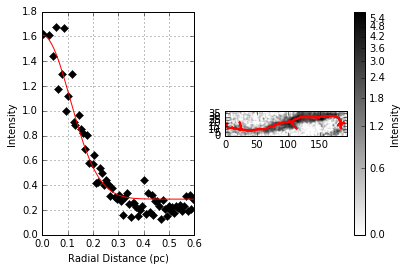

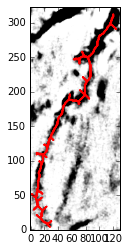

0 in 1
Fit Parameters: [ 5.68627914  0.10329837  0.43954252  0.20954875] 
Fit Errors: [ 0.02801122  0.00224115  0.03209529  0.00612624]
Fit Type: gaussian


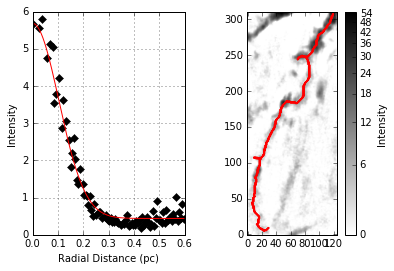

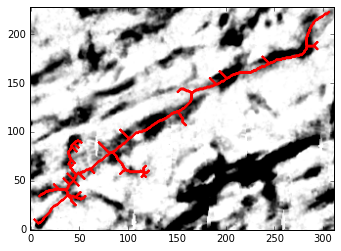

0 in 1
Fit Parameters: [ 4.765079    0.15138436  0.27040181  0.33439594] 
Fit Errors: [ 0.0199111   0.00318653  0.03025561  0.00799934]
Fit Type: gaussian


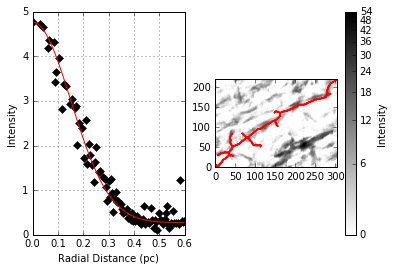

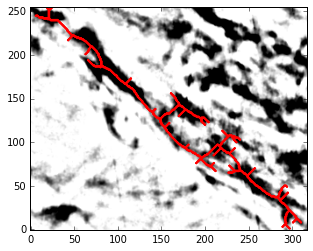

0 in 1
Fit Parameters: [ 8.4542329   0.11800015  1.82395946  0.24890122] 
Fit Errors: [ 0.08719904  0.00533995  0.08594869  0.01403809]
Fit Type: gaussian


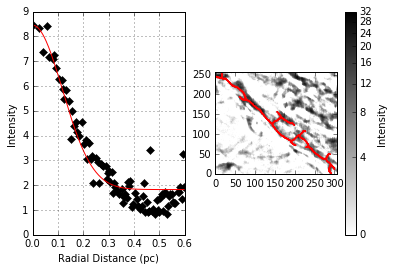

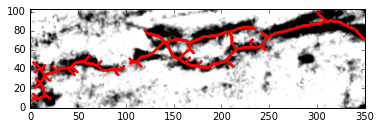

0 in 2
Fit Parameters: [ 2.24768812  0.1099709   0.23057592  0.22759991] 
Fit Errors: [ 0.0154908   0.00365479  0.01483993  0.00979227]
Fit Type: gaussian


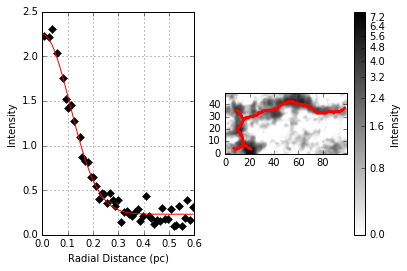

1 in 2
Fit Parameters: [ 2.28109546  0.15253109  0.27482641  0.33727316] 
Fit Errors: [ 0.0196952   0.00362222  0.01553381  0.00908378]
Fit Type: gaussian


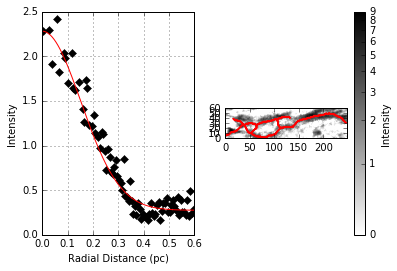

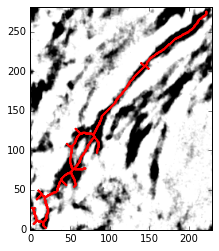

0 in 1
Fit Parameters: [ 4.94338547  0.0811122   0.92253645  0.1456823 ] 
Fit Errors: [ 0.15908781  0.01197212  0.04753617  0.0369629 ]
Fit Type: gaussian


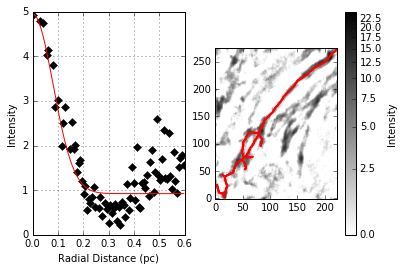

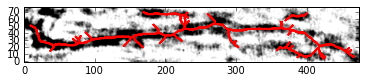

0 in 2
Fit Parameters: [ 3.31901507  0.14383781  0.54763414  0.31538308] 
Fit Errors: [ 0.02388399  0.00479285  0.02553783  0.01212115]
Fit Type: gaussian


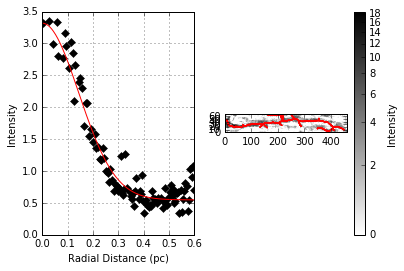

1 in 2
Fit Parameters: [ 4.09933251  0.12031581  0.09305318  0.25497444] 
Fit Errors: [ 0.08980507  0.010929    0.22357299  0.0285971 ]
Fit Type: gaussian


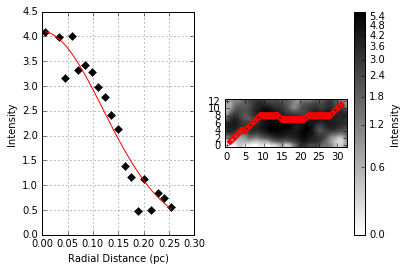

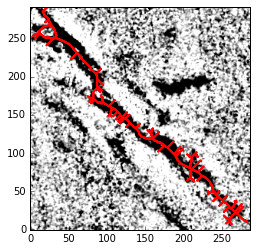

0 in 1
Fit Parameters: [ 1.13283013  0.11951769  0.16873047  0.25288441] 
Fit Errors: [ 0.00607151  0.00269896  0.0067217   0.00707331]
Fit Type: gaussian


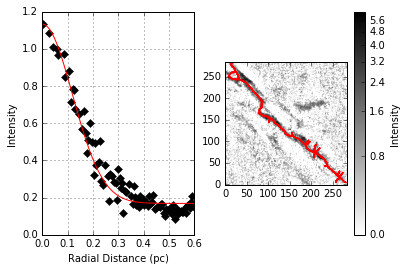

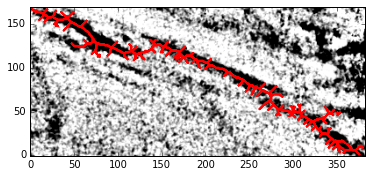

0 in 1
Fit Parameters: [ 1.03760774  0.10037801  0.14976068  0.20152508] 
Fit Errors: [ 0.00204257  0.00122587  0.00393159  0.00338587]
Fit Type: gaussian


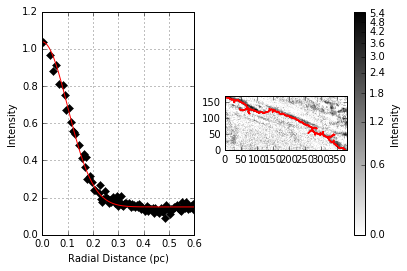

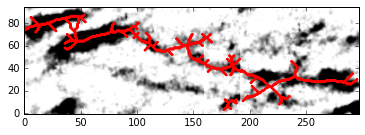

0 in 2
Fit Parameters: [ 1.14037853  0.13126134 -0.03606095  0.28333976] 
Fit Errors: [ 0.07772335  0.07227443  0.64242999  0.18566474]
Fit Type: gaussian


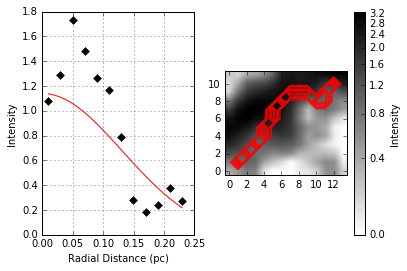

1 in 2
Fit Parameters: [ 2.20309749  0.10755739  0.41481666  0.22111188] 
Fit Errors: [ 0.02288568  0.00472889  0.02259648  0.01275565]
Fit Type: gaussian


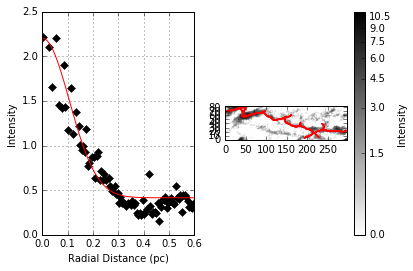

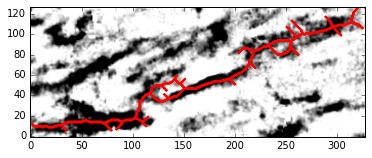

0 in 1
Fit Parameters: [ 2.6952502   0.12433459  0.45176536  0.26545048] 
Fit Errors: [ 0.02812429  0.00568123  0.02515525  0.01475591]
Fit Type: gaussian


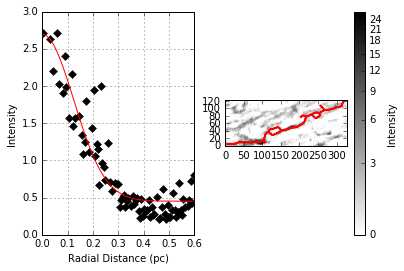

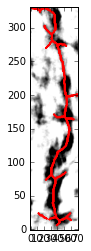

0 in 2
Fit Parameters: [ 8.25611757  0.14521785  0.87662271  0.31887068] 
Fit Errors: [ 0.0726728   0.0042495   0.06269184  0.01073146]
Fit Type: gaussian


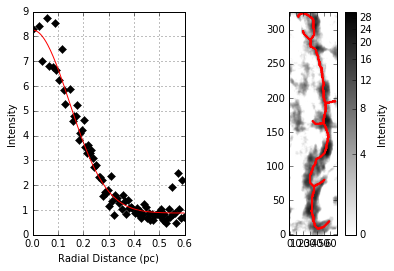

1 in 2
Fit Parameters: [  1.55289735e+00   9.72637592e+00  -2.17065344e+03   2.29035319e+01] 
Fit Errors: [  1.24444341e-01   3.81287616e+04   1.70279931e+07   8.97876780e+04]
Fit Type: gaussian


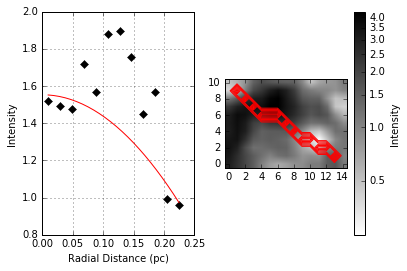

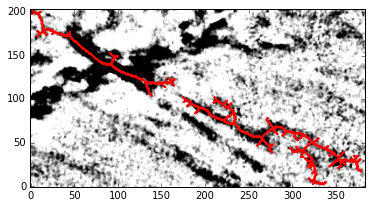

0 in 2
Fit Parameters: [ 0.84519372  0.10303727  0.21434467  0.20883469] 
Fit Errors: [ 0.0079357   0.0054144   0.00918802  0.01481349]
Fit Type: gaussian


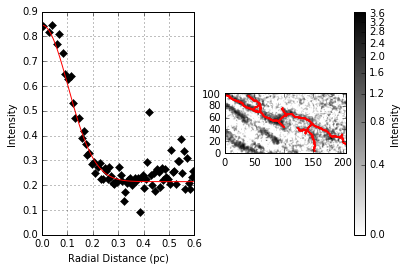

1 in 2
Fit Parameters: [ 1.18442189  0.19236688  0.75216157  0.43582101] 
Fit Errors: [ 0.03429434  0.07196958  0.1101662   0.17615159]
Fit Type: gaussian


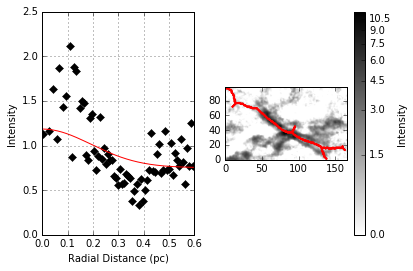

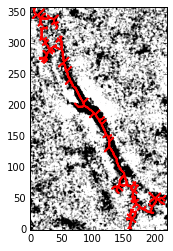

0 in 4
Fit Parameters: [ 0.56916037  0.06443191  0.1336103   0.08809772] 
Fit Errors: [ 0.06044232  0.02277417  0.02327528  0.09236223]
Fit Type: gaussian


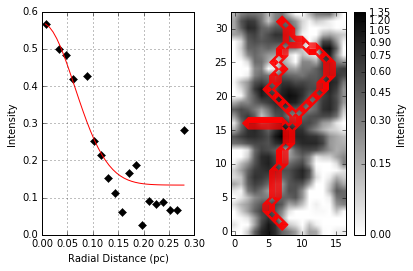

1 in 4
Fit Parameters: [ 0.92652182  0.14012793  0.1419642   0.30598163] 
Fit Errors: [ 0.00608871  0.0037474   0.00819209  0.00951645]
Fit Type: gaussian


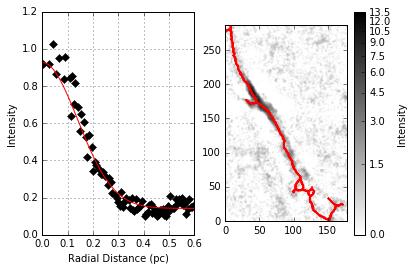

2 in 4
Fit Parameters: [ 0.464368    0.24726186  0.06692305  0.56900263] 
Fit Errors: [ 0.03624635  0.08572732  0.10014027  0.20657491]
Fit Type: gaussian


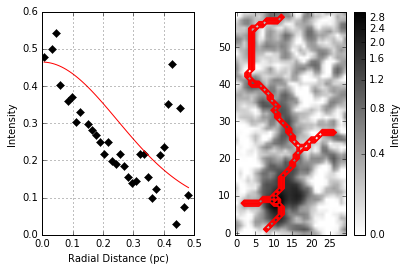

3 in 4
Fit Parameters: [ 0.40630339  0.34642559 -0.00080779  0.8063629 ] 
Fit Errors: [ 0.01821509  0.16913644  0.22584107  0.40293229]
Fit Type: gaussian


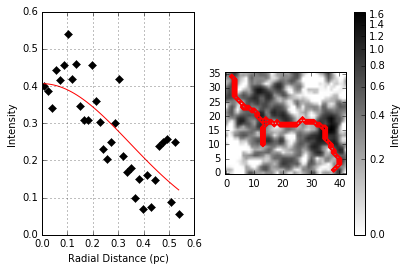

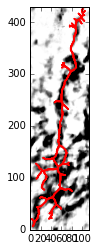

0 in 1
Fit Parameters: [ 26.26905244   0.18750476   6.29470153   0.42390813] 
Fit Errors: [ 0.23908124  0.00922623  0.48467735  0.02262979]
Fit Type: gaussian


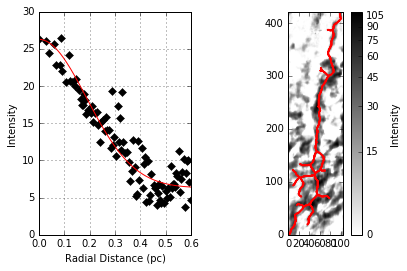

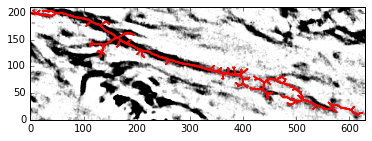

0 in 2
Fit Parameters: [ 1.02188897  0.16322878  0.18978189  0.36398386] 
Fit Errors: [ 0.00764544  0.00518184  0.0118805   0.01288589]
Fit Type: gaussian


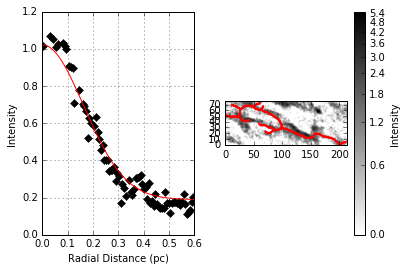

1 in 2
Fit Parameters: [ 3.18388944  0.14143708  0.17515477  0.30930369] 
Fit Errors: [ 0.01371043  0.00250501  0.01433879  0.0063519 ]
Fit Type: gaussian


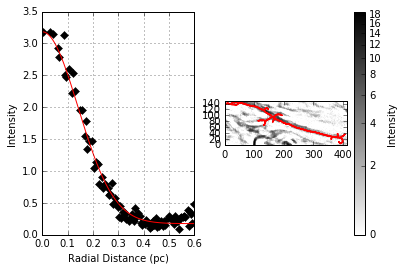

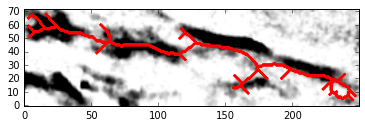

0 in 1
Fit Parameters: [ 2.43457982  0.17535875  0.15122651  0.39402869] 
Fit Errors: [ 0.03148764  0.00769792  0.04245709  0.01899714]
Fit Type: gaussian


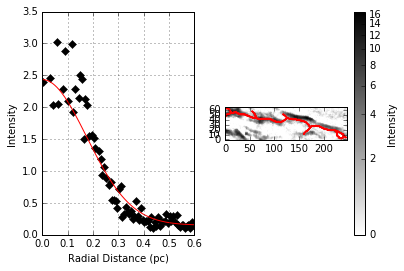

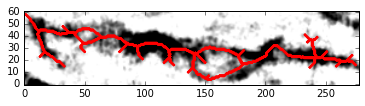

0 in 1
Fit Parameters: [ 3.2844001   0.1184254   0.29836391  0.25001865] 
Fit Errors: [ 0.02646143  0.00270861  0.01679096  0.00711435]
Fit Type: gaussian


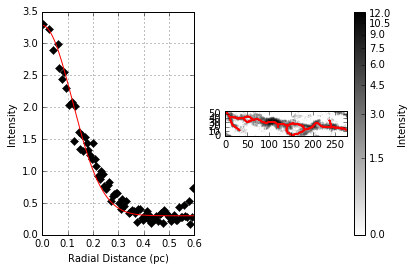

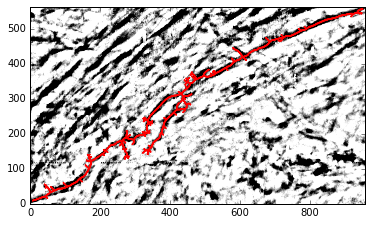

0 in 1
Fit Parameters: [ 6.02710154  0.12896369  0.93270528  0.27742733] 
Fit Errors: [ 0.01595389  0.00221178  0.01994279  0.00570131]
Fit Type: gaussian


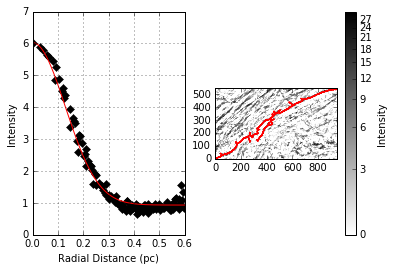

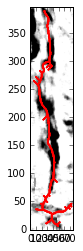

0 in 1
Fit Parameters: [ 5.34571968  0.0719661   2.06113896  0.11601596] 
Fit Errors: [ 0.12673382  0.01044794  0.08586635  0.0359382 ]
Fit Type: gaussian


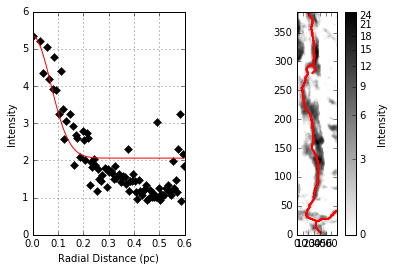

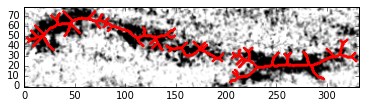

0 in 3
Fit Parameters: [ 0.8666366   0.13976357  0.11833727  0.30505617] 
Fit Errors: [ 0.01220626  0.00690142  0.00963775  0.01753347]
Fit Type: gaussian


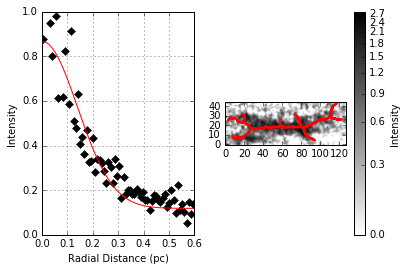

1 in 3
Fit Parameters: [  8.25269062e-01   1.53104826e+01  -1.99476360e+03   3.60532196e+01] 
Fit Errors: [  1.78354969e-02   7.84117919e+03   2.04372192e+06   1.84646743e+04]
Fit Type: gaussian


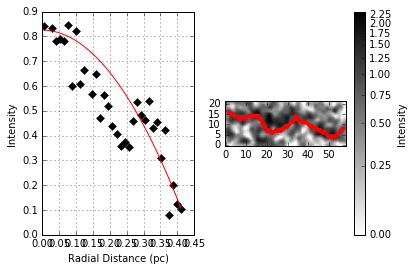

2 in 3
Fit Parameters: [ 1.04435582  0.17852487  0.13206939  0.40183533] 
Fit Errors: [ 0.00706689  0.00575401  0.01406517  0.01417545]
Fit Type: gaussian


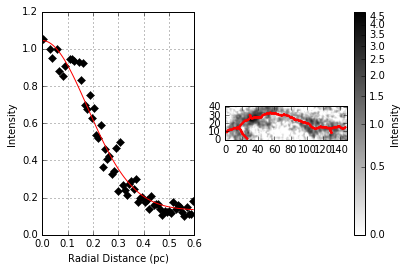

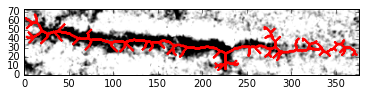

0 in 1
Fit Parameters: [ 1.10802225  0.11042566  0.15433945  0.2288176 ] 
Fit Errors: [ 0.01291289  0.005323    0.01111778  0.01424466]
Fit Type: gaussian


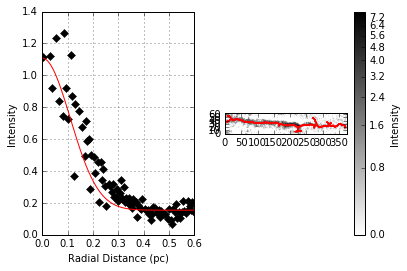

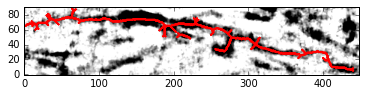

0 in 2
Fit Parameters: [ 2.91597783  0.10489725  0.50174466  0.21390782] 
Fit Errors: [ 0.02921611  0.00400409  0.02521169  0.01088821]
Fit Type: gaussian


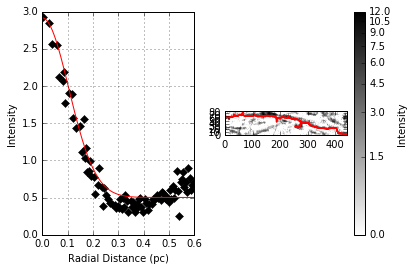

1 in 2
Fit Parameters: [ 4.24253883  0.04526549  1.37015382  0.        ] 
Fit Errors: [ 0.0934658   0.00517421  0.06493115  0.        ]
Fit Type: gaussian


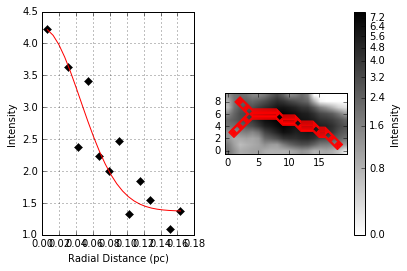

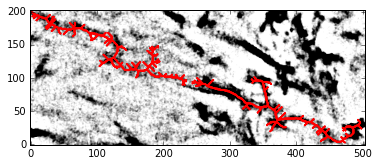

0 in 2
Fit Parameters: [ 2.98299989  0.10812058  0.26644039  0.22262979] 
Fit Errors: [ 0.01658634  0.00245811  0.01832597  0.00661975]
Fit Type: gaussian


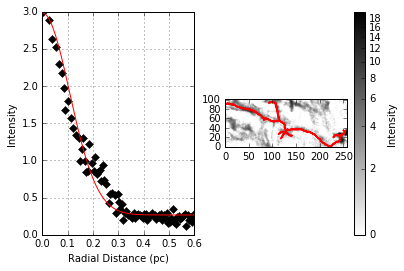

1 in 2
Fit Parameters: [ 1.27273999  0.1259653   0.35470674  0.26968004] 
Fit Errors: [ 0.00501706  0.00348647  0.01073308  0.00903033]
Fit Type: gaussian


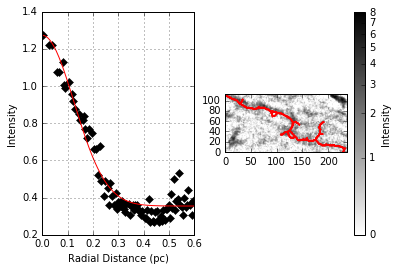

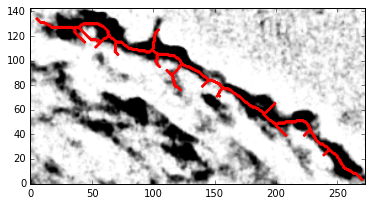

0 in 1
Fit Parameters: [ 4.66726634  0.10889534  0.26245352  0.22471395] 
Fit Errors: [ 0.03203669  0.00236192  0.03178071  0.00634688]
Fit Type: gaussian


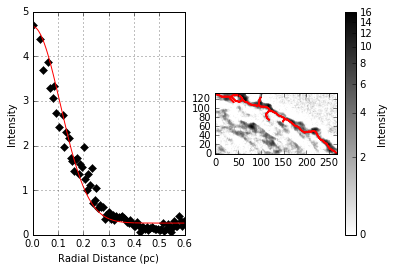

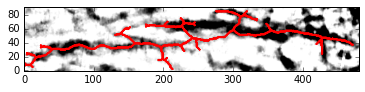

0 in 1
Fit Parameters: [ 6.94776371  0.09577463  1.72858323  0.18869353] 
Fit Errors: [ 0.08880663  0.00558597  0.06139569  0.01572199]
Fit Type: gaussian


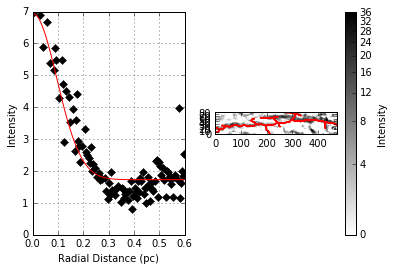

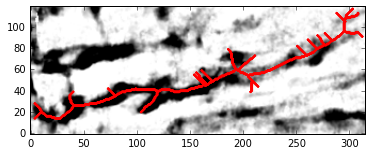

0 in 1
Fit Parameters: [ 7.21406546  0.11890208  0.36997038  0.25127007] 
Fit Errors: [ 0.03190427  0.00200686  0.03107175  0.005266  ]
Fit Type: gaussian


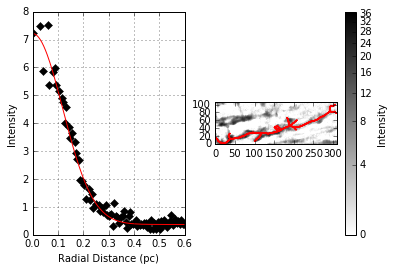

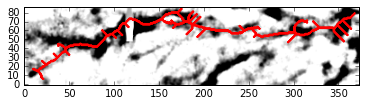

0 in 1
Fit Parameters: [ 4.59829837  0.10638564  1.17391412  0.21794576] 
Fit Errors: [ 0.04717484  0.00517553  0.04401987  0.01400893]
Fit Type: gaussian


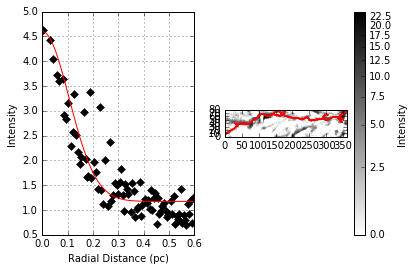

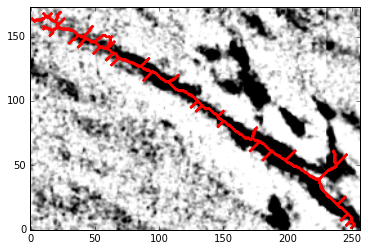

0 in 1
Fit Parameters: [ 1.85478245  0.0943655   0.17451146  0.18471471] 
Fit Errors: [ 0.01520065  0.00315144  0.01828783  0.00892763]
Fit Type: gaussian


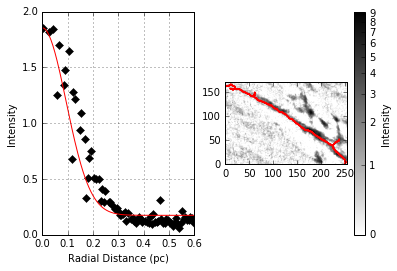

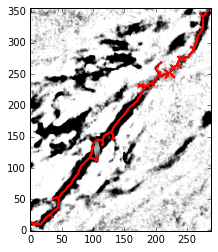

0 in 2
Fit Parameters: [ 9.03141155  0.1181434   0.66858922  0.24927773] 
Fit Errors: [ 0.07321961  0.00414165  0.08616226  0.01088465]
Fit Type: gaussian


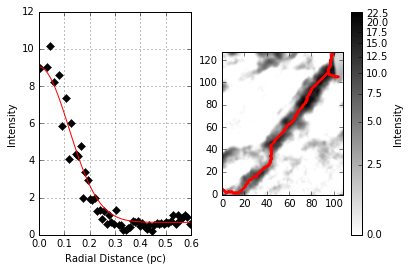

1 in 2
Fit Parameters: [ 3.8016493   0.09991254  0.36353936  0.20023833] 
Fit Errors: [ 0.02449952  0.00247324  0.02777689  0.00684312]
Fit Type: gaussian


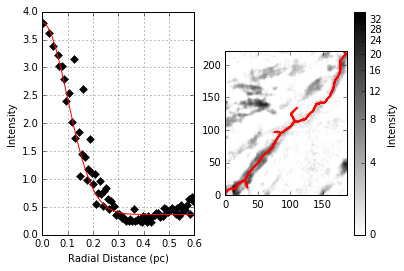

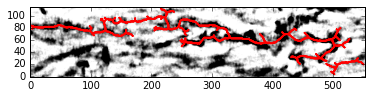

0 in 2
Fit Parameters: [ 2.46160976  0.12597514  0.62037682  0.26970552] 
Fit Errors: [ 0.04316374  0.01362196  0.07219849  0.03528176]
Fit Type: gaussian


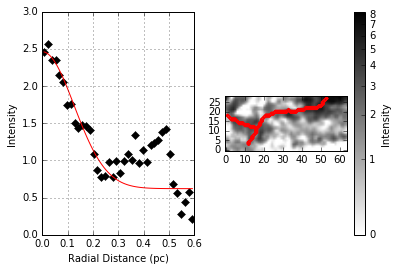

1 in 2
Fit Parameters: [ 6.98230689  0.10151339  1.34474713  0.20465444] 
Fit Errors: [ 0.04036635  0.00358454  0.0405266   0.0098594 ]
Fit Type: gaussian


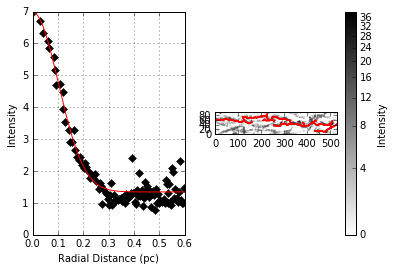

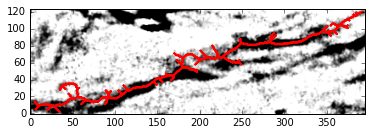

0 in 1
Fit Parameters: [ 2.019493    0.11813919  0.34596179  0.24926666] 
Fit Errors: [ 0.01017002  0.00290401  0.01310513  0.00763209]
Fit Type: gaussian


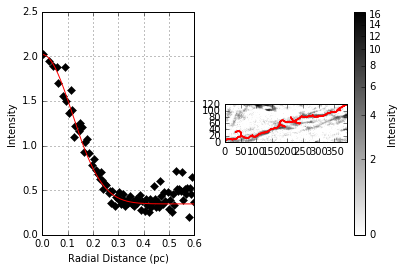

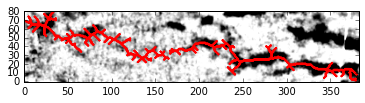

0 in 3
Fit Parameters: [ 4.32542526  0.09005131  0.41613577  0.1723593 ] 
Fit Errors: [ 0.03141425  0.0028663   0.04489543  0.00830411]
Fit Type: gaussian


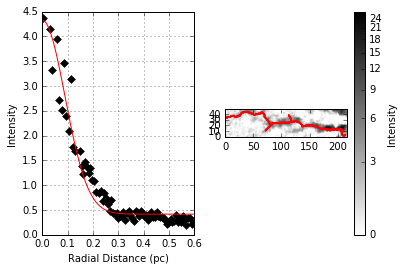

1 in 3
Fit Parameters: [ 1.41725268  0.14414711  0.63955314  0.31616517] 
Fit Errors: [ 0.01396074  0.01032163  0.03026285  0.02609489]
Fit Type: gaussian


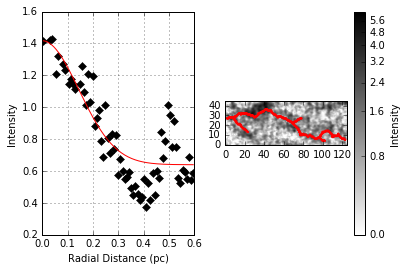

2 in 3
Fit Parameters: [ 3.50603438  0.07363251  0.61399298  0.12167625] 
Fit Errors: [ 0.0822251   0.00840511  0.04190078  0.02820477]
Fit Type: gaussian


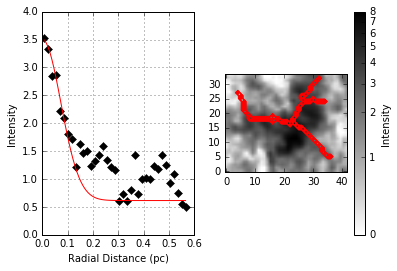

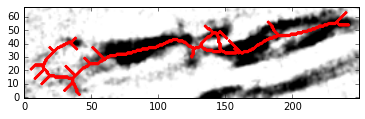

0 in 1
Fit Parameters: [ 2.49559631  0.15115741  0.2748372   0.33382615] 
Fit Errors: [ 0.03633657  0.00858016  0.04469468  0.02154369]
Fit Type: gaussian


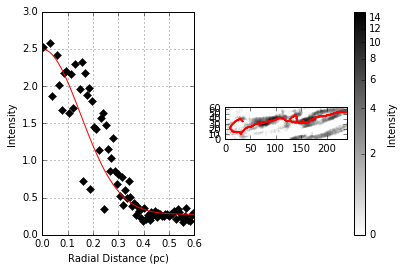

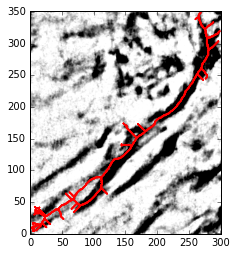

0 in 1
Fit Parameters: [ 7.23567056  0.15241412  0.76658108  0.33697982] 
Fit Errors: [ 0.04423797  0.00405984  0.07326632  0.01018229]
Fit Type: gaussian


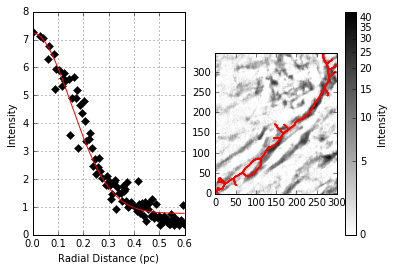

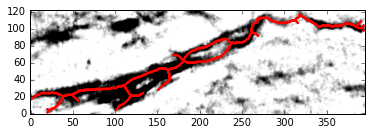

0 in 1
Fit Parameters: [ 4.54880716  0.14353514  0.35545741  0.31461749] 
Fit Errors: [ 0.06430468  0.00506506  0.04053908  0.01281371]
Fit Type: gaussian


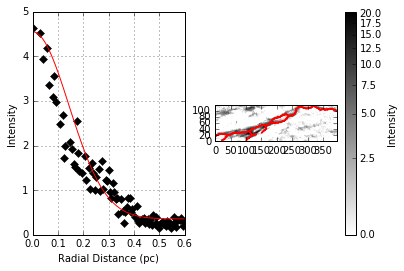

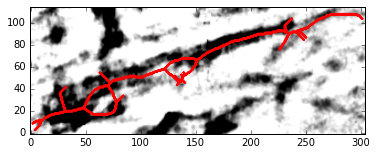

0 in 1
Fit Parameters: [ 3.29342468  0.18046596  0.51902259  0.40661492] 
Fit Errors: [ 0.03373773  0.00641443  0.05009701  0.01578648]
Fit Type: gaussian


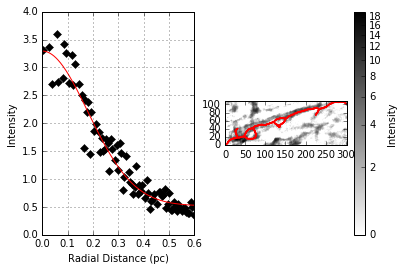

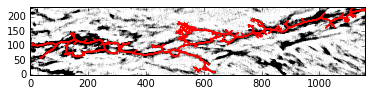

0 in 2
Fit Parameters: [ 5.96410591  0.14003296  0.71012811  0.30574046] 
Fit Errors: [ 0.01077517  0.00195447  0.02290711  0.00496388]
Fit Type: gaussian


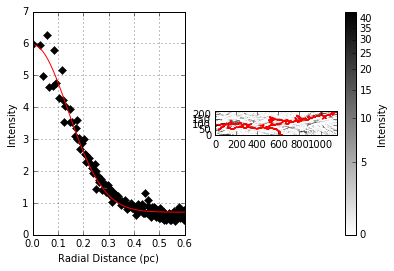

1 in 2
Fit Parameters: [  2.45361462e+00   2.57951904e+01   1.11432526e+04   6.07429058e+01] 
Fit Errors: [  1.94043361e-01   3.30176588e+04   2.85156622e+07   7.77508056e+04]
Fit Type: gaussian


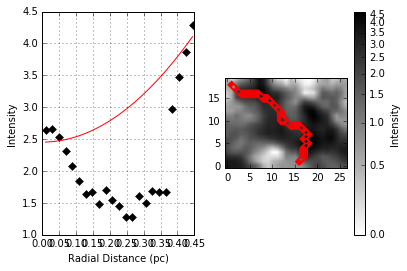

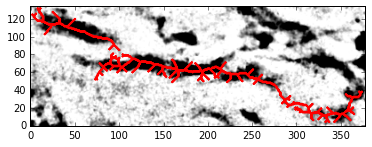

0 in 2
Fit Parameters: [ 2.01714749  0.11911927  0.20863829  0.25183985] 
Fit Errors: [ 0.01110341  0.00274153  0.0154284   0.00719062]
Fit Type: gaussian


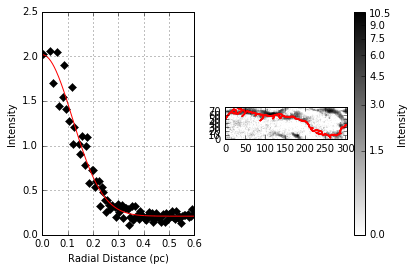

1 in 2
Fit Parameters: [ 2.21284386  0.18179525  0.02380639  0.40988532] 
Fit Errors: [ 0.03515361  0.01392258  0.08391846  0.03424169]
Fit Type: gaussian


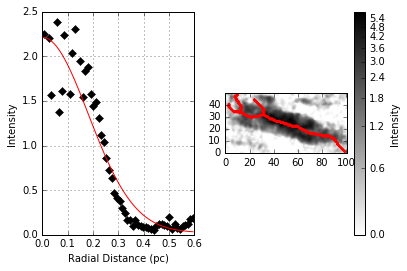

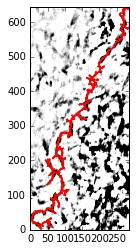

0 in 3
Fit Parameters: [ 7.39451171  0.07879426  1.21829227  0.13844852] 
Fit Errors: [ 0.09783987  0.00547129  0.06741386  0.01726678]
Fit Type: gaussian


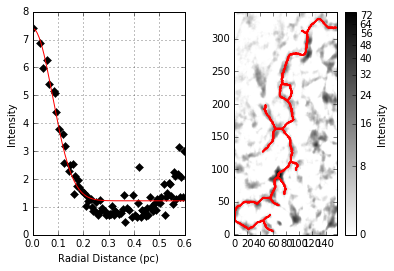

1 in 3
Fit Parameters: [ 6.4965644   0.06804618  1.31287958  0.1020603 ] 
Fit Errors: [ 0.08988086  0.00510632  0.0826856   0.01887863]
Fit Type: gaussian


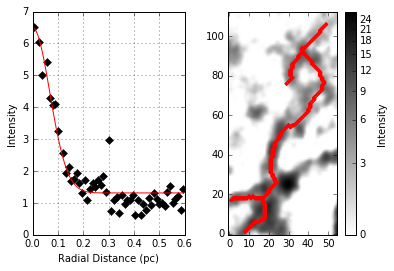

2 in 3
Fit Parameters: [ 6.18952851  0.0902334   1.07832816  0.17288658] 
Fit Errors: [ 0.15960719  0.00949068  0.09158772  0.02746747]
Fit Type: gaussian


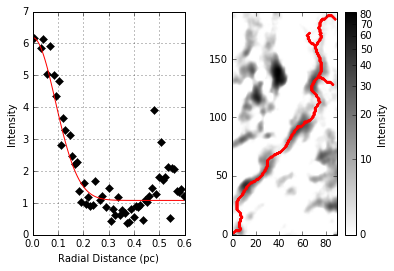

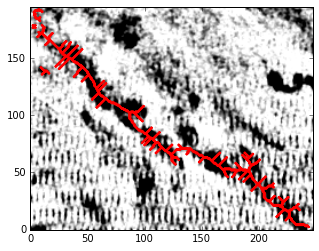

0 in 3
Fit Parameters: [ 1.95510926  0.10855228  0.43712587  0.22379165] 
Fit Errors: [ 0.01447393  0.00424975  0.02003946  0.01143072]
Fit Type: gaussian


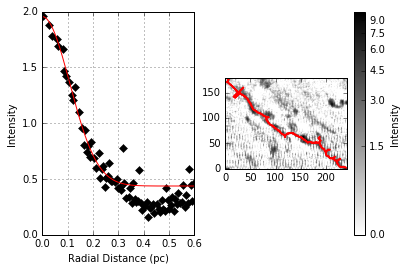

1 in 3
Fit Parameters: [ 2.18077939  0.03542272  0.52496704  0.        ] 
Fit Errors: [ 0.06369575  0.00286098  0.04450114  0.        ]
Fit Type: gaussian


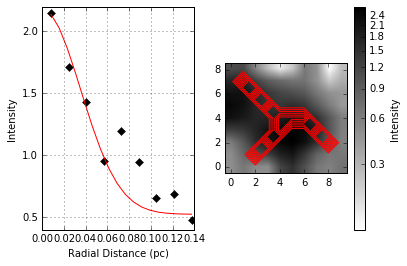

2 in 3
Fit Parameters: [  6.72568009e-01   5.31429479e+00  -2.17075198e+03   1.25135982e+01] 
Fit Errors: [  1.23427589e-01   2.03487841e+04   1.66279447e+07   4.79200594e+04]
Fit Type: gaussian


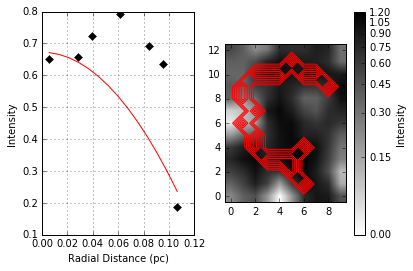

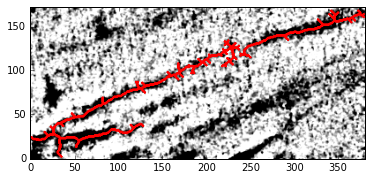

0 in 2
Fit Parameters: [ 1.10969452  0.07986326  0.26696378  0.14180439] 
Fit Errors: [ 0.01199439  0.00473265  0.01364581  0.01478009]
Fit Type: gaussian


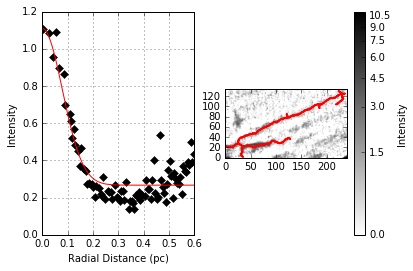

1 in 2
Fit Parameters: [ 1.24121512  0.09639024  0.17744131  0.19042385] 
Fit Errors: [ 0.00920776  0.00287422  0.01508735  0.00806767]
Fit Type: gaussian


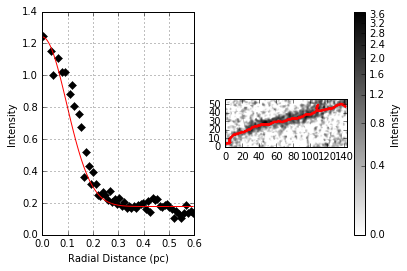

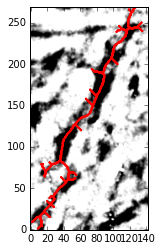

0 in 1
Fit Parameters: [ 3.24633471  0.17788918  0.4325599   0.400269  ] 
Fit Errors: [ 0.03607354  0.00872605  0.04681317  0.02150457]
Fit Type: gaussian


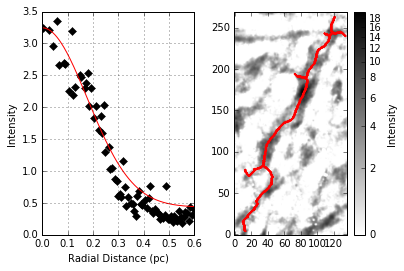

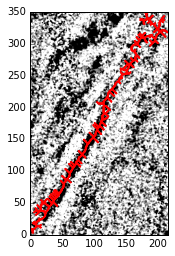

0 in 1
Fit Parameters: [ 0.64988278  0.12007585  0.14882129  0.2543464 ] 
Fit Errors: [ 0.00360244  0.00328265  0.00414937  0.0085935 ]
Fit Type: gaussian


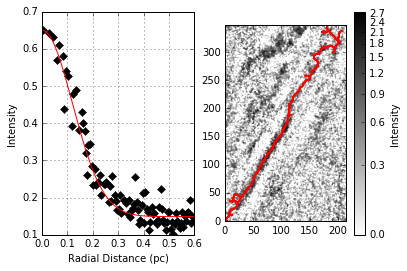

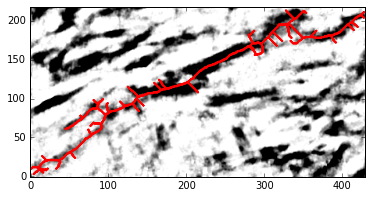

0 in 1
Fit Parameters: [ 4.73060241  0.14003156  0.51117186  0.30573691] 
Fit Errors: [ 0.02660636  0.00306495  0.02529629  0.00778426]
Fit Type: gaussian


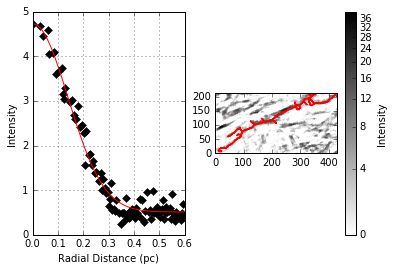

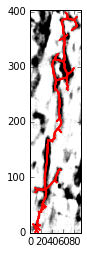

0 in 1
Fit Parameters: [ 6.75302595  0.07878667  0.64493012  0.13842457] 
Fit Errors: [ 0.05462711  0.00242737  0.030316    0.0076611 ]
Fit Type: gaussian


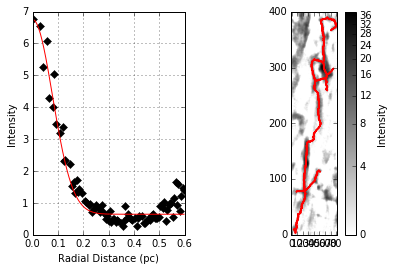

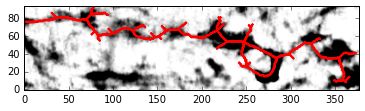

0 in 1
Fit Parameters: [ 6.12525441  0.10807639  0.64310712  0.22251076] 
Fit Errors: [ 0.01741328  0.00155485  0.02357967  0.00418779]
Fit Type: gaussian


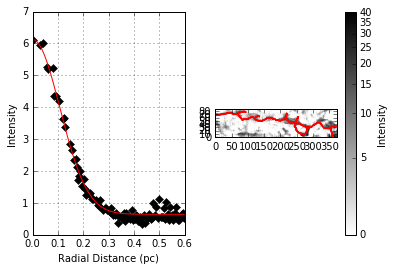

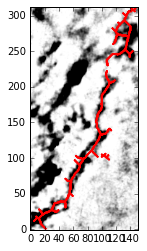

0 in 3
Fit Parameters: [ 9.01529398  0.10075371  0.27326467  0.20256204] 
Fit Errors: [ 0.05114015  0.00223834  0.06424606  0.00617369]
Fit Type: gaussian


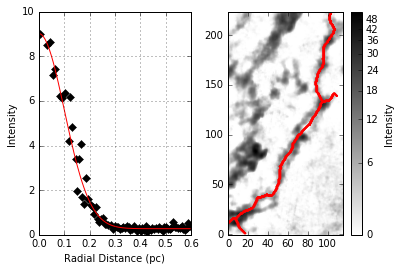

1 in 3
Fit Parameters: [   0.85509742    9.39670048 -748.82207464   22.12719384] 
Fit Errors: [  2.26632940e-01   2.82496990e+05   4.50231052e+07   6.65239941e+05]
Fit Type: gaussian


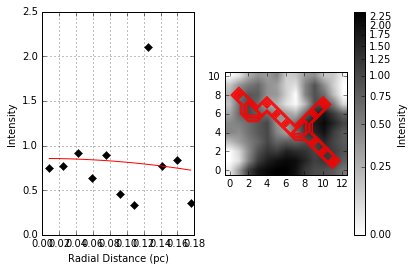

2 in 3
Fit Parameters: [ 7.54787731  0.07896545  1.21426095  0.1389883 ] 
Fit Errors: [ 0.15460089  0.00642399  0.10156253  0.02023853]
Fit Type: gaussian


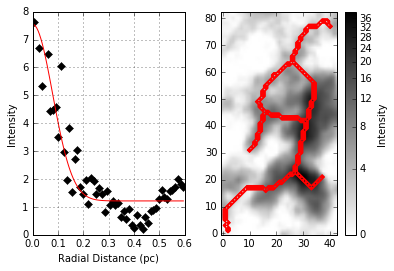

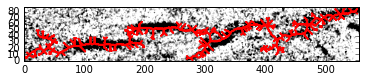

0 in 2
Fit Parameters: [ 0.78354452  0.0959509   0.21461095  0.18918947] 
Fit Errors: [ 0.00320849  0.00267921  0.00383336  0.00753484]
Fit Type: gaussian


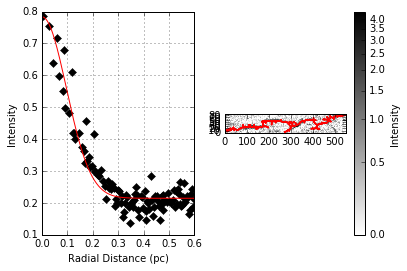

1 in 2
Fit Parameters: [ 0.5349544   0.07514189  0.25128517  0.12668985] 
Fit Errors: [ 0.00908868  0.0083478   0.00729713  0.0274554 ]
Fit Type: gaussian


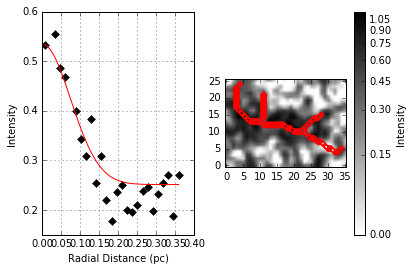

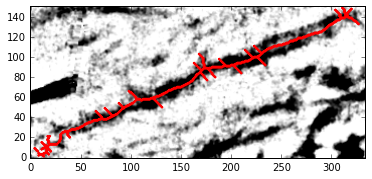

0 in 1
Fit Parameters: [ 1.88627426  0.16206779  0.13655958  0.36109558] 
Fit Errors: [ 0.00794527  0.00311785  0.01549061  0.00775972]
Fit Type: gaussian


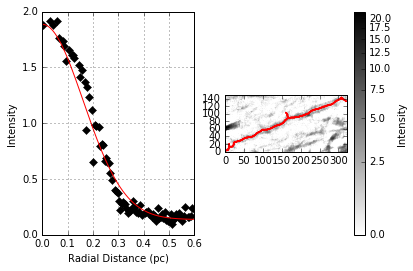

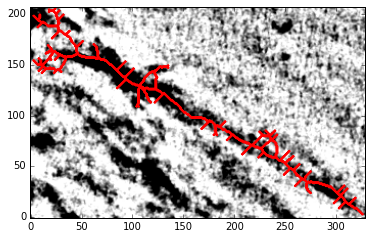

0 in 1
Fit Parameters: [ 2.06715983  0.13138312  0.4744616   0.28365255] 
Fit Errors: [ 0.01359256  0.0045436   0.02417199  0.01166994]
Fit Type: gaussian


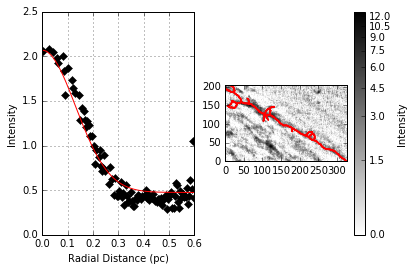

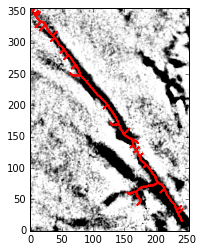

0 in 1
Fit Parameters: [ 3.53209515  0.11727203  0.27183043  0.24698561] 
Fit Errors: [ 0.02294612  0.00238552  0.02179381  0.00628089]
Fit Type: gaussian


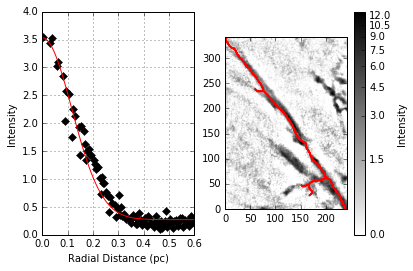

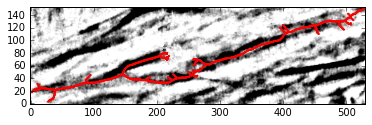

0 in 1
Fit Parameters: [ 3.66154376  0.20196591  0.37293427  0.45927074] 
Fit Errors: [ 0.02493581  0.00706945  0.0645721   0.01723894]
Fit Type: gaussian


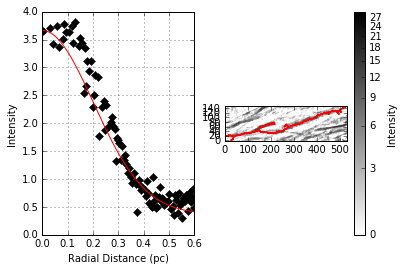

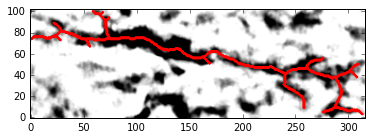

0 in 1
Fit Parameters: [ 6.50083303  0.11471175  0.95803346  0.24022566] 
Fit Errors: [ 0.06074392  0.00393374  0.04715197  0.01041621]
Fit Type: gaussian


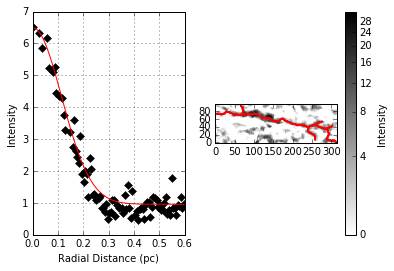

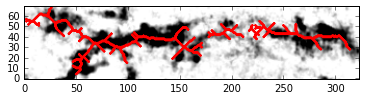

0 in 3
Fit Parameters: [ 2.73925444  0.15996392  0.12888677  0.35585542] 
Fit Errors: [ 0.01954185  0.00470073  0.03021196  0.01171735]
Fit Type: gaussian


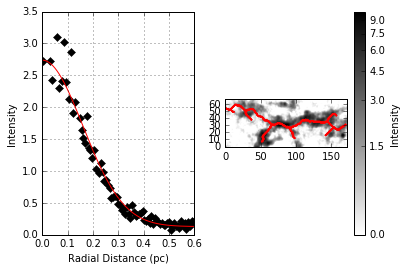

1 in 3
Fit Parameters: [ 2.33215538  0.21266642  0.25612977  0.48531673] 
Fit Errors: [ 0.05709945  0.02168612  0.07658422  0.0526952 ]
Fit Type: gaussian


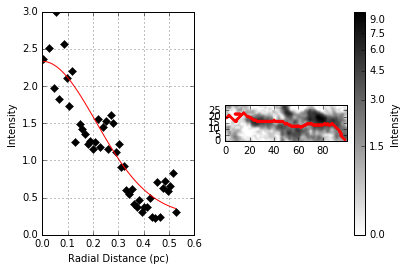

2 in 3
Fit Parameters: [ 0.95699304  0.13857721  0.45766461  0.30204001] 
Fit Errors: [ 0.06746303  0.09334938  0.19023269  0.23749485]
Fit Type: gaussian


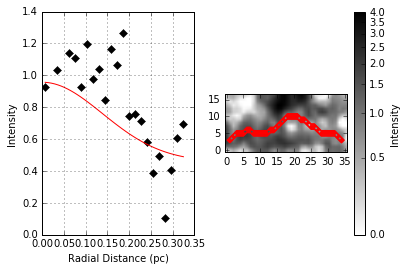

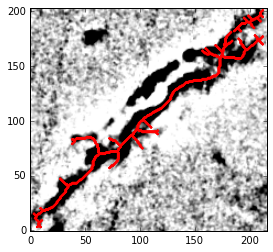

0 in 2
Fit Parameters: [ 4.18800101  0.11463641  0.21723471  0.24002613] 
Fit Errors: [ 0.01210268  0.00152145  0.01971109  0.00402938]
Fit Type: gaussian


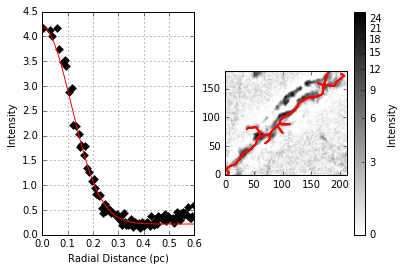

1 in 2
Fit Parameters: [ 4.38942579  0.09999398  0.42894121  0.20046363] 
Fit Errors: [ 0.04067071  0.00516323  0.02876419  0.01428155]
Fit Type: gaussian


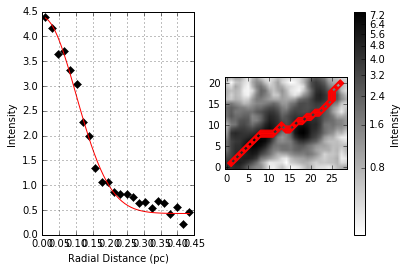

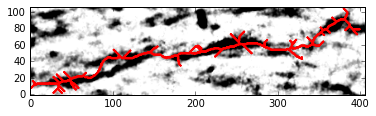

0 in 1
Fit Parameters: [ 3.34267848  0.11271413  0.38177015  0.23492367] 
Fit Errors: [ 0.02147434  0.00308906  0.02301468  0.00821851]
Fit Type: gaussian


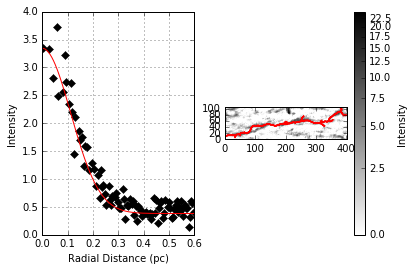

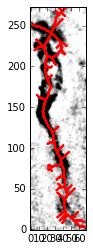

0 in 1
Fit Parameters: [ 3.45109485  0.11794812  0.35034369  0.24876441] 
Fit Errors: [ 0.01338121  0.00219115  0.02296739  0.0057609 ]
Fit Type: gaussian


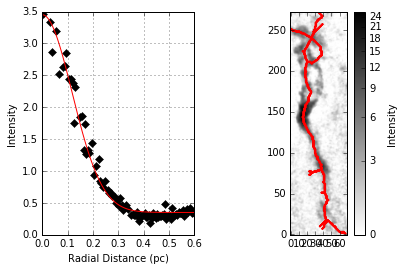

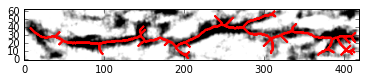

0 in 1
Fit Parameters: [ 4.48649343  0.09613264  0.9904626   0.18970037] 
Fit Errors: [ 0.04199994  0.00476579  0.02641261  0.01339225]
Fit Type: gaussian


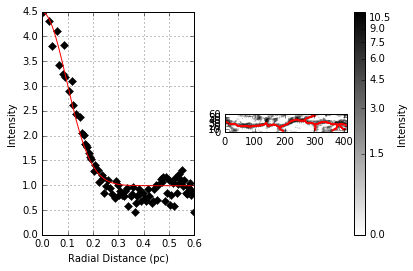

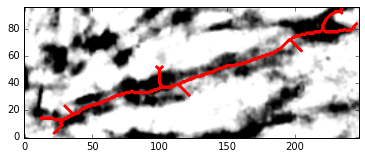

0 in 1
Fit Parameters: [ 3.02329947  0.15754511  0.42297509  0.34982057] 
Fit Errors: [ 0.05177635  0.00833422  0.04921828  0.02081326]
Fit Type: gaussian


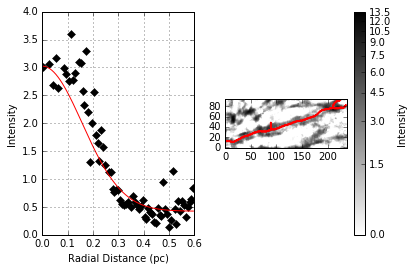

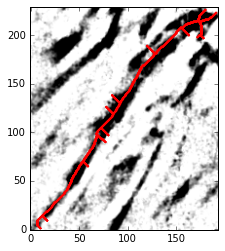

0 in 1
Fit Parameters: [ 2.75263111  0.13378745  0.48715922  0.28981744] 
Fit Errors: [ 0.04192937  0.00574568  0.03804155  0.0147078 ]
Fit Type: gaussian


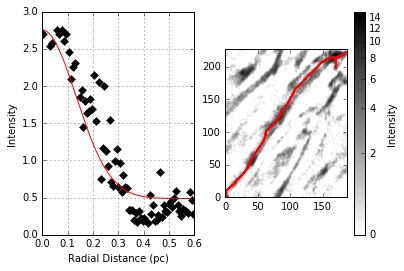

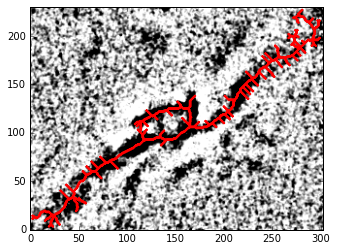

0 in 1
Fit Parameters: [ 1.34646714  0.12364877  0.18168724  0.26366813] 
Fit Errors: [ 0.00449263  0.00208146  0.006299    0.00541272]
Fit Type: gaussian


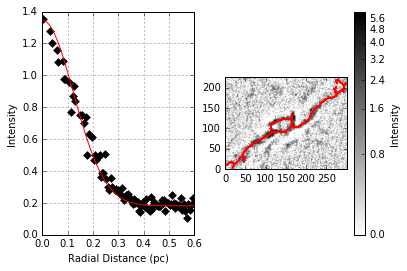

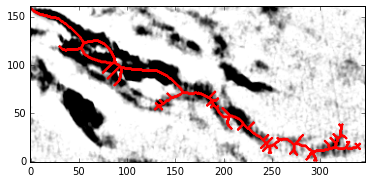

0 in 1
Fit Parameters: [ 4.19615991  0.12764933  0.39929578  0.27403583] 
Fit Errors: [ 0.02313169  0.00293502  0.02344185  0.00758121]
Fit Type: gaussian


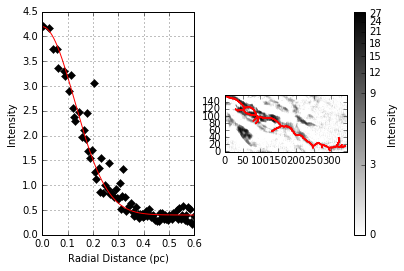

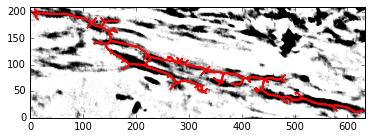

0 in 2
Fit Parameters: [ 3.09587076  0.12723433  0.67515127  0.27296352] 
Fit Errors: [ 0.05345173  0.00820945  0.03851882  0.02121921]
Fit Type: gaussian


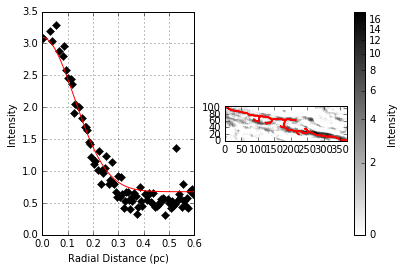

1 in 2
Fit Parameters: [ 2.88989865  0.09073649  1.00991757  0.17434053] 
Fit Errors: [ 0.14938884  0.02880883  0.0799756   0.08314281]
Fit Type: gaussian


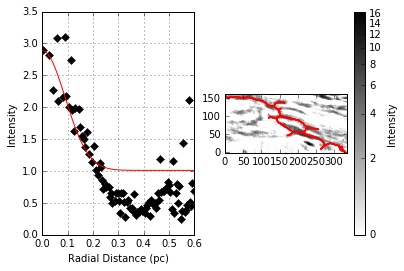

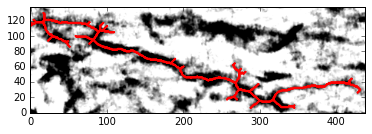

0 in 1
Fit Parameters: [ 4.20247172  0.11267236  0.83529784  0.23481253] 
Fit Errors: [ 0.02949173  0.00384833  0.0282052   0.01023961]
Fit Type: gaussian


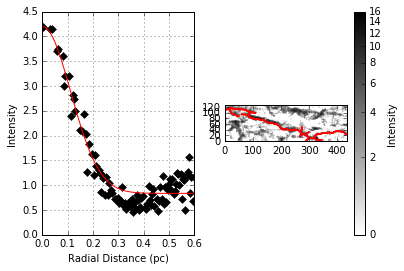

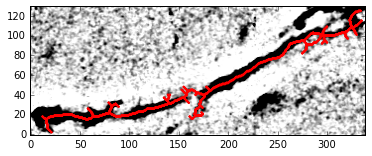

0 in 1
Fit Parameters: [ 2.70638833  0.05560497  1.34784905  0.04342544] 
Fit Errors: [ 0.21022691  0.04543869  0.15868239  0.32263442]
Fit Type: gaussian


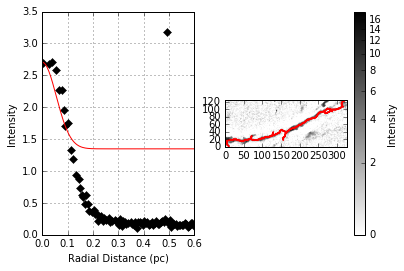

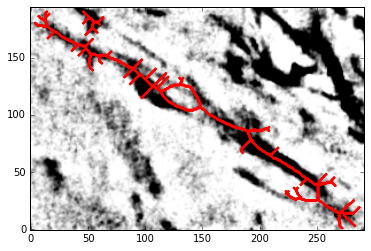

0 in 2
Fit Parameters: [ 2.70201061  0.09125239  0.29423942  0.17582731] 
Fit Errors: [ 0.01659357  0.00346434  0.02197565  0.00996997]
Fit Type: gaussian


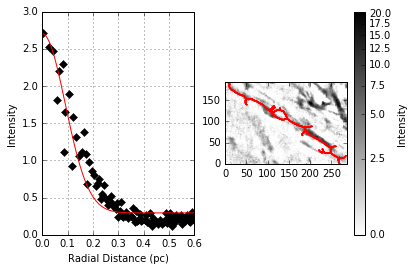

1 in 2
Fit Parameters: [ 5.03131241  0.09085666  0.89461538  0.17468722] 
Fit Errors: [ 0.15232251  0.01362883  0.10896686  0.03930697]
Fit Type: gaussian


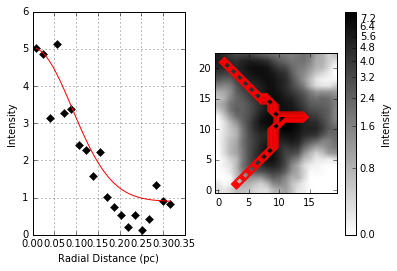

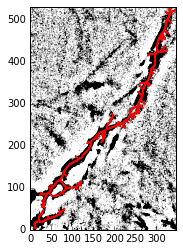

0 in 2
Fit Parameters: [ 7.00066894  0.08829094  0.30073932  0.16723286] 
Fit Errors: [ 0.09828507  0.004016    0.08782664  0.0117572 ]
Fit Type: gaussian


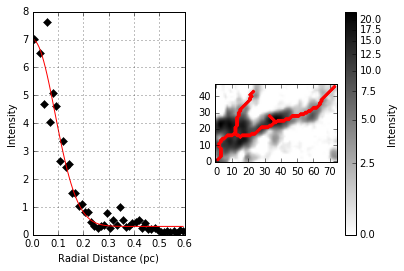

1 in 2
Fit Parameters: [ 3.34687884  0.11389809  0.20945105  0.23806911] 
Fit Errors: [ 0.01137072  0.00181596  0.01213742  0.00481765]
Fit Type: gaussian


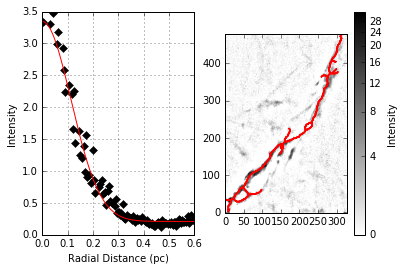

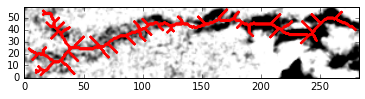

0 in 1
Fit Parameters: [ 1.1133678   0.15151802  0.16387064  0.33473144] 
Fit Errors: [ 0.00733963  0.00372989  0.01014424  0.00936223]
Fit Type: gaussian


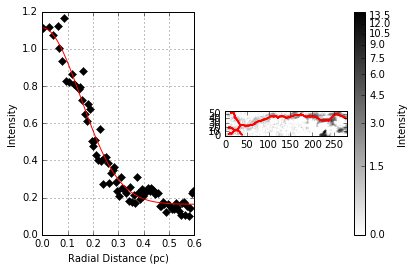

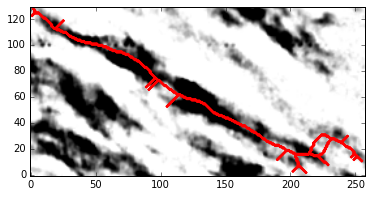

0 in 1
Fit Parameters: [ 4.04026295  0.18514741  0.11986922  0.41812298] 
Fit Errors: [ 0.04484344  0.0052304   0.02111557  0.01284293]
Fit Type: gaussian


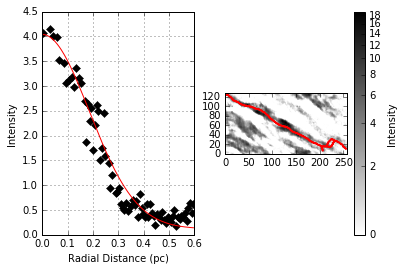

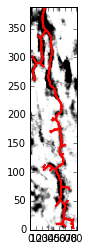

0 in 1
Fit Parameters: [ 2.86243445  0.0883144   0.43037583  0.16730153] 
Fit Errors: [ 0.03801112  0.00492429  0.0222803   0.01441419]
Fit Type: gaussian


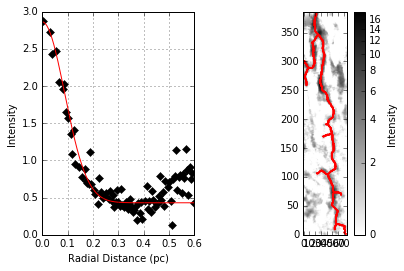

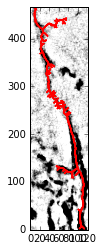

0 in 1
Fit Parameters: [ 3.0771626   0.11583535  0.33574872  0.24319705] 
Fit Errors: [ 0.00911598  0.00192143  0.01755097  0.00507484]
Fit Type: gaussian


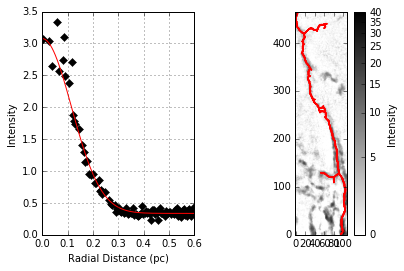

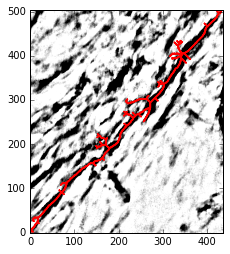

0 in 1
Fit Parameters: [ 11.64281501   0.10512552   2.09415755   0.21452833] 
Fit Errors: [ 0.09625704  0.00485134  0.09560669  0.0131826 ]
Fit Type: gaussian


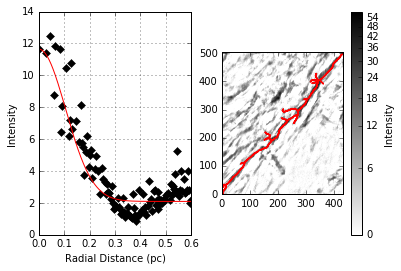

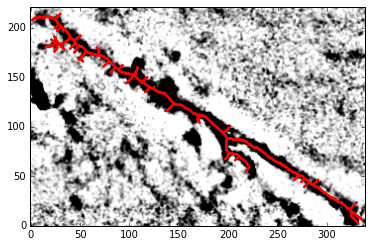

0 in 1
Fit Parameters: [ 1.62457099  0.11219463  0.16482052  0.23354063] 
Fit Errors: [ 0.00855724  0.00218024  0.00787313  0.00580805]
Fit Type: gaussian


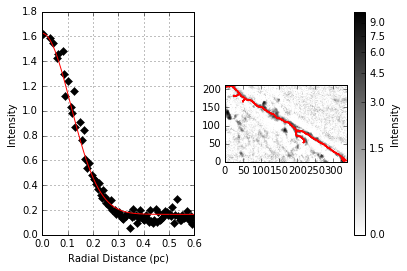

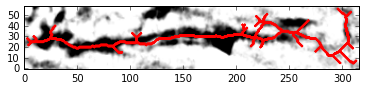

0 in 1
Fit Parameters: [ 4.27254234  0.10905689  0.44297043  0.22514796] 
Fit Errors: [ 0.06483031  0.00550977  0.0221268   0.01479905]
Fit Type: gaussian


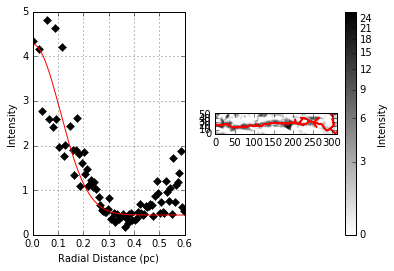

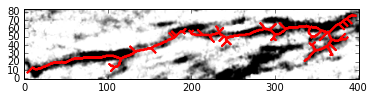

0 in 2
Fit Parameters: [ 2.56850412  0.13568145  0.17432543  0.29465956] 
Fit Errors: [ 0.04587319  0.00843823  0.03947653  0.021546  ]
Fit Type: gaussian


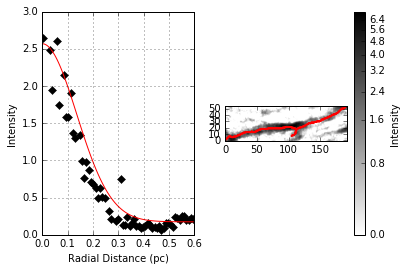

1 in 2
Fit Parameters: [ 2.40987682  0.08853739  0.68095425  0.16795383] 
Fit Errors: [ 0.02974134  0.00637653  0.03588035  0.01863959]
Fit Type: gaussian


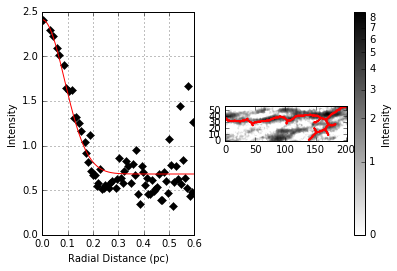

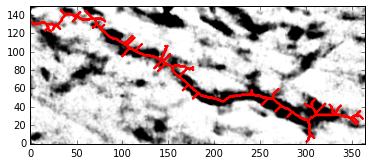

0 in 1
Fit Parameters: [ 4.17171896  0.12303969  0.28318806  0.26208338] 
Fit Errors: [ 0.01310484  0.00181813  0.01779866  0.00473312]
Fit Type: gaussian


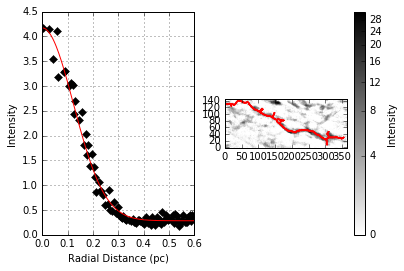

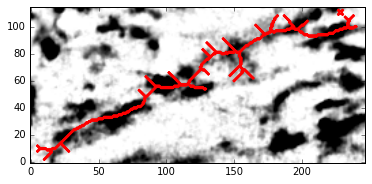

0 in 1
Fit Parameters: [ 2.71726454  0.14611271  0.28547857  0.32112947] 
Fit Errors: [ 0.01605462  0.00360145  0.02957734  0.00908658]
Fit Type: gaussian


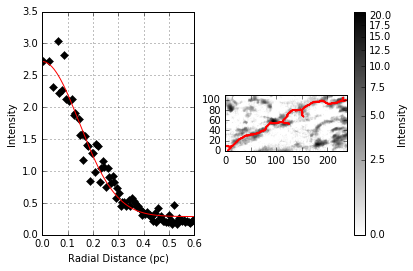

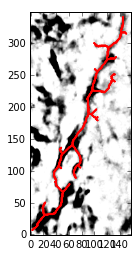

0 in 1
Fit Parameters: [ 5.79496713  0.08746127  0.61988914  0.16479761] 
Fit Errors: [ 0.05463068  0.00401682  0.04189515  0.01182124]
Fit Type: gaussian


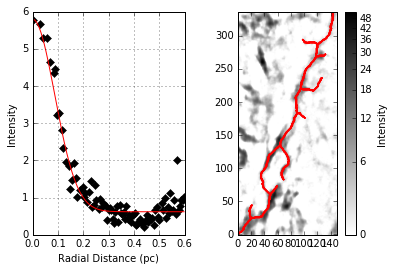

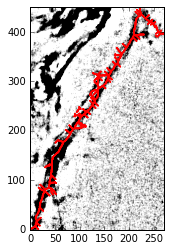

0 in 2
Fit Parameters: [ 2.11261276  0.15602532  0.16537413  0.34602285] 
Fit Errors: [ 0.00743811  0.0023917   0.01099525  0.00598015]
Fit Type: gaussian


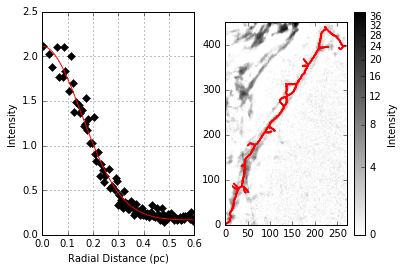

1 in 2
Fit Parameters: [ 0.98321496  0.03791466  0.3093964   0.        ] 
Fit Errors: [ 0.03370501  0.00856859  0.02580273  0.        ]
Fit Type: gaussian


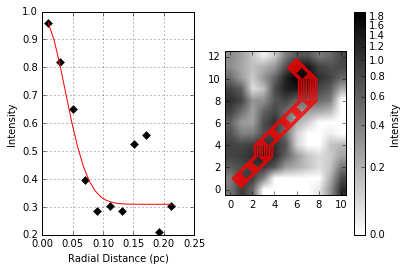

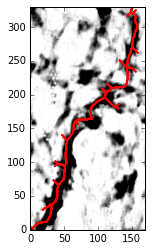

0 in 1
Fit Parameters: [ 16.12042199   0.14870571   1.56297664   0.32766328] 
Fit Errors: [ 0.07330066  0.00318559  0.13035698  0.00801689]
Fit Type: gaussian


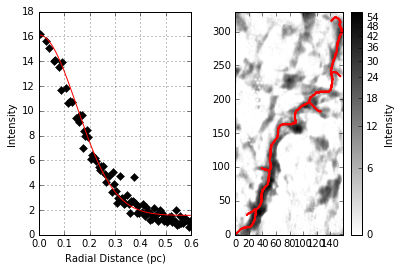

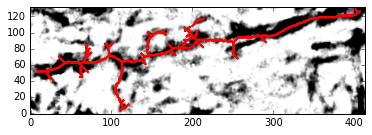

0 in 2
Fit Parameters: [ 3.37971515  0.1435251   0.57910189  0.3145921 ] 
Fit Errors: [ 0.02756892  0.00446587  0.02611762  0.011298  ]
Fit Type: gaussian


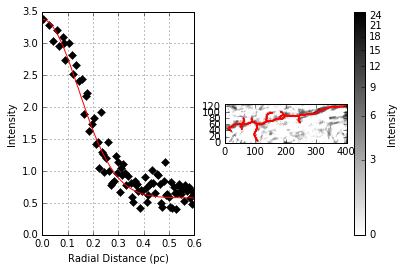

1 in 2
Fit Parameters: [ 3.08642012  0.1355674  -1.24304852  0.29436833] 
Fit Errors: [ 0.1152102   0.05180083  2.16374345  0.13228674]
Fit Type: gaussian


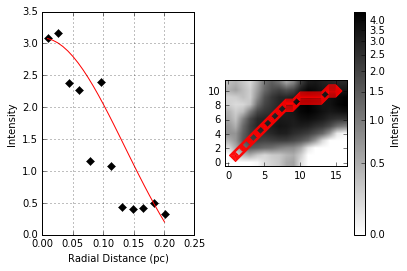

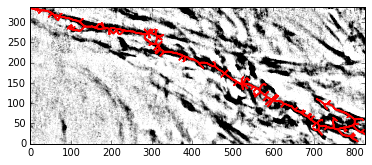

0 in 1
Fit Parameters: [ 7.62425898  0.12875862  0.61448069  0.27689864] 
Fit Errors: [ 0.01036123  0.00123499  0.02378928  0.00318446]
Fit Type: gaussian


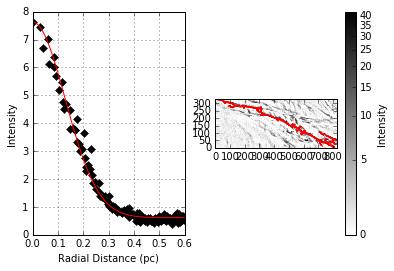

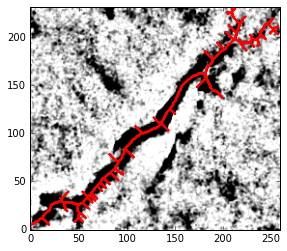

0 in 1
Fit Parameters: [ 2.75968769  0.09476064  0.23291323  0.18583304] 
Fit Errors: [ 0.0112327   0.00197006  0.01320542  0.00557059]
Fit Type: gaussian


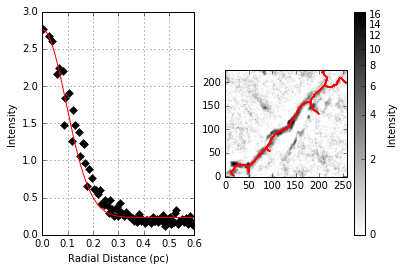

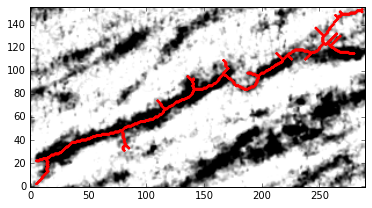

0 in 2
Fit Parameters: [ 3.19592251  0.12169604  0.24655621  0.25858118] 
Fit Errors: [ 0.01286501  0.00178216  0.01103806  0.00465095]
Fit Type: gaussian


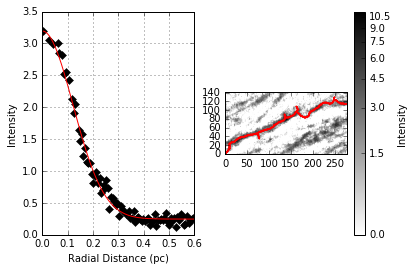

1 in 2
Fit Parameters: [  6.52247714e-01   1.71875514e+01   4.81974794e+03   4.04734020e+01] 
Fit Errors: [  1.99573483e-01   5.13375507e+04   2.87861163e+07   1.20891257e+05]
Fit Type: gaussian


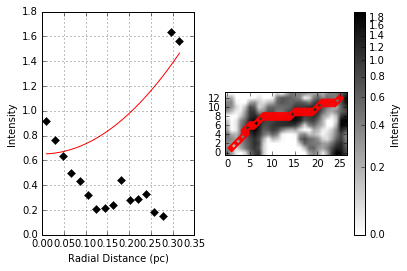

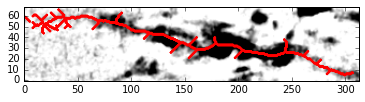

0 in 1
Fit Parameters: [ 1.80606222  0.13836158  0.47395091  0.30149135] 
Fit Errors: [ 0.04024072  0.01008311  0.05101011  0.02565964]
Fit Type: gaussian


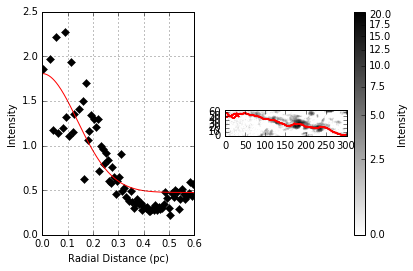

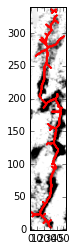

0 in 3
Fit Parameters: [ 2.26981778  0.08574388  0.28150037  0.15971468] 
Fit Errors: [ 0.02423477  0.00352799  0.01662009  0.01050272]
Fit Type: gaussian


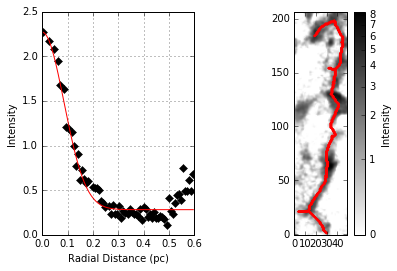

1 in 3
Fit Parameters: [ 0.87754057  0.14154645  0.08992181  0.30958101] 
Fit Errors: [ 0.01635342  0.00817067  0.01348856  0.02071562]
Fit Type: gaussian


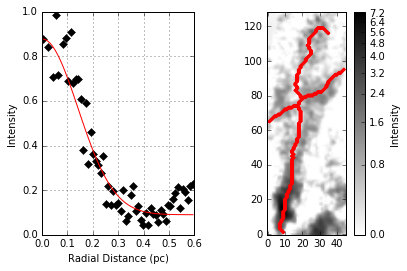

2 in 3
Fit Parameters: [  4.40630560e-01   4.74117800e+00  -6.03711119e+02   1.11639376e+01] 
Fit Errors: [  3.03755119e-01   2.29808003e+05   5.85611068e+07   5.41189619e+05]
Fit Type: gaussian


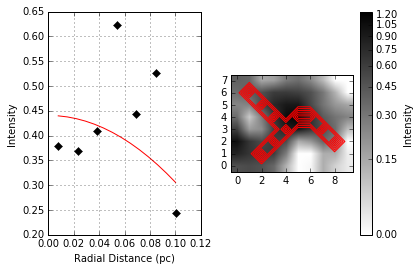

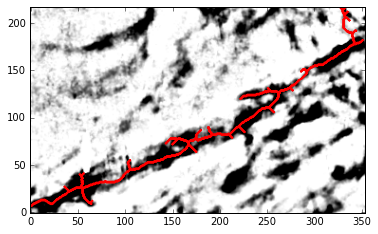

0 in 2
Fit Parameters: [ 7.38091085  0.12545869  0.48697425  0.2683673 ] 
Fit Errors: [ 0.03606948  0.00257902  0.03204105  0.00668561]
Fit Type: gaussian


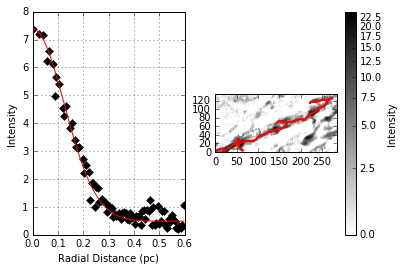

1 in 2
Fit Parameters: [ 4.9235155   0.20520248  0.46566088  0.46715867] 
Fit Errors: [ 0.13905763  0.0352732   0.57678449  0.08591689]
Fit Type: gaussian


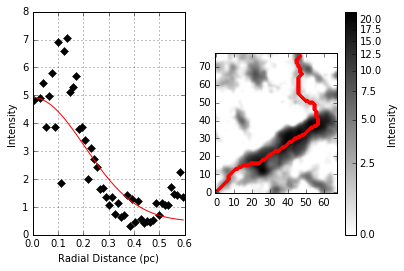

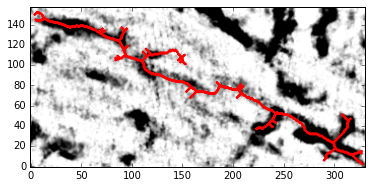

0 in 2
Fit Parameters: [ 3.27898718  0.10859446  0.46470976  0.2239051 ] 
Fit Errors: [ 0.00928461  0.00182712  0.0183892   0.0049139 ]
Fit Type: gaussian


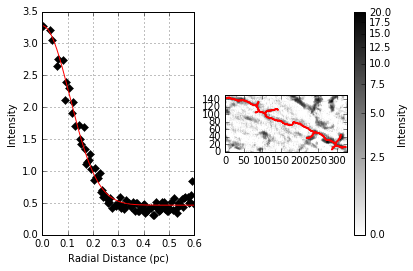

1 in 2
Fit Parameters: [ 0.7580847   0.05095354  0.23337623  0.        ] 
Fit Errors: [ 0.00791146  0.00428772  0.02008832  0.        ]
Fit Type: gaussian


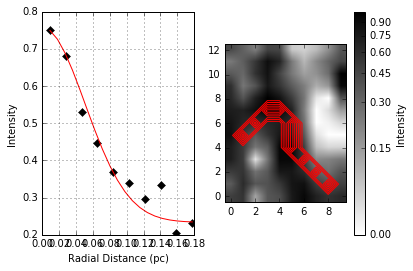

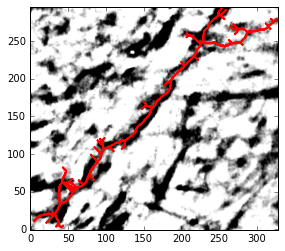

0 in 1
Fit Parameters: [ 5.05184581  0.15259397  0.85579958  0.33743085] 
Fit Errors: [ 0.0352997   0.00376671  0.0352402   0.00944561]
Fit Type: gaussian


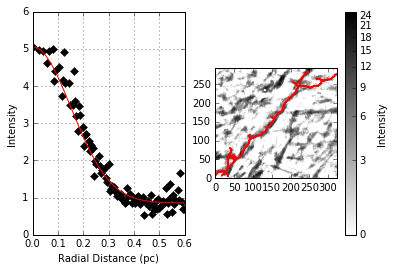

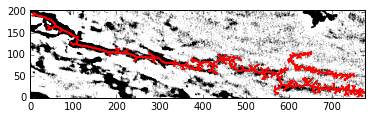

0 in 3
Fit Parameters: [ 1.03261469  0.14313659  0.20373563  0.31360904] 
Fit Errors: [ 0.00660494  0.00481613  0.00699069  0.01218922]
Fit Type: gaussian


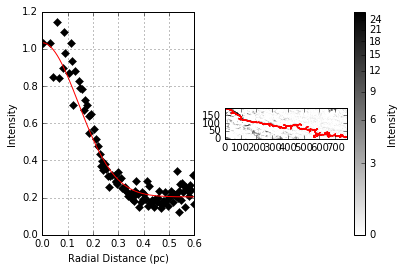

1 in 3
Fit Parameters: [ 0.49742371  0.14526058  0.06946792  0.31897857] 
Fit Errors: [ 0.027375    0.02656901  0.0108062   0.06709298]
Fit Type: gaussian


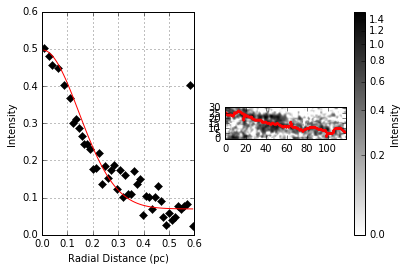

2 in 3
Fit Parameters: [ 0.43408495  0.30347996  0.04095293  0.70388343] 
Fit Errors: [ 0.04443828  0.12928847  0.15904952  0.30910394]
Fit Type: gaussian


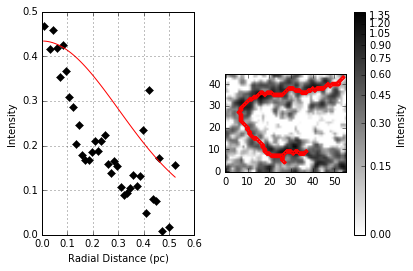

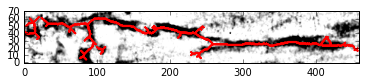

0 in 3
Fit Parameters: [ 2.80725001  0.10854976  0.20759928  0.22378487] 
Fit Errors: [ 0.01641457  0.00252458  0.00866159  0.00679053]
Fit Type: gaussian


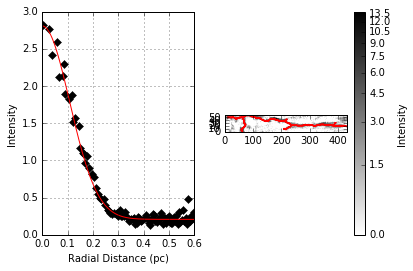

1 in 3
Fit Parameters: [ 2.2680262   0.06576696 -0.04773608  0.09340812] 
Fit Errors: [ 0.07086921  0.01028676  0.21453062  0.04016216]
Fit Type: gaussian


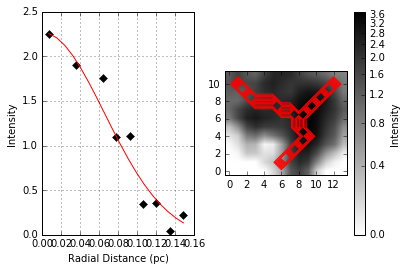

2 in 3
Fit Parameters: [ 2.03601737  0.17037903 -0.30654674  0.38172189] 
Fit Errors: [ 0.08176552  0.04656015  0.48926993  0.11523885]
Fit Type: gaussian


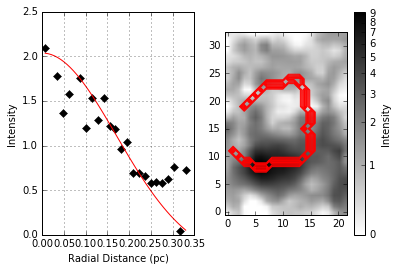

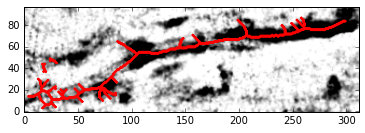

0 in 1
Fit Parameters: [ 2.24786412  0.11188314  0.44537654  0.23271053] 
Fit Errors: [ 0.01901698  0.00466308  0.02349543  0.01243187]
Fit Type: gaussian


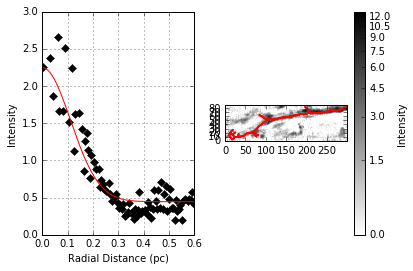

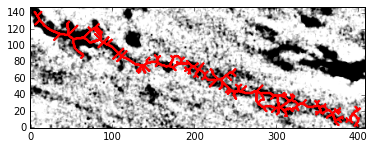

0 in 4
Fit Parameters: [  6.36401850e-01   7.78038760e+00  -3.14152215e+03   1.83209962e+01] 
Fit Errors: [  2.14047357e-01   5.66656440e+04   4.57661229e+07   1.33440427e+05]
Fit Type: gaussian


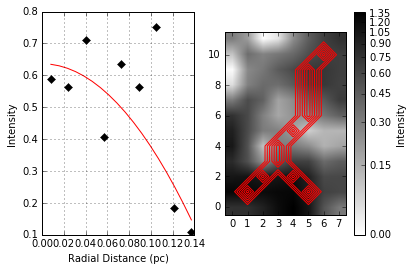

1 in 4
Fit Parameters: [ 1.16077145  0.0674349   0.14407711  0.09978511] 
Fit Errors: [ 0.02635798  0.00755967  0.02679517  0.02832938]
Fit Type: gaussian


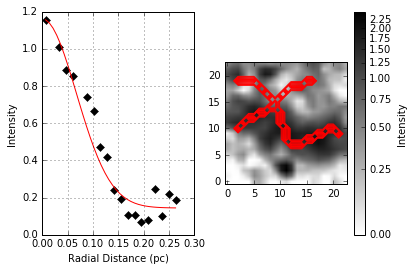

2 in 4
Fit Parameters: [ 0.46119631  0.16512931  0.10417611  0.36870684] 
Fit Errors: [ 0.02329454  0.05272227  0.07743433  0.13093402]
Fit Type: gaussian


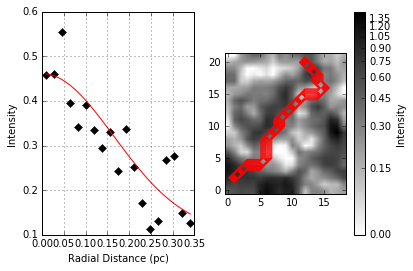

3 in 4
Fit Parameters: [ 1.15756663  0.10586357  0.19493743  0.21653152] 
Fit Errors: [ 0.00481714  0.00218327  0.00560584  0.00591899]
Fit Type: gaussian


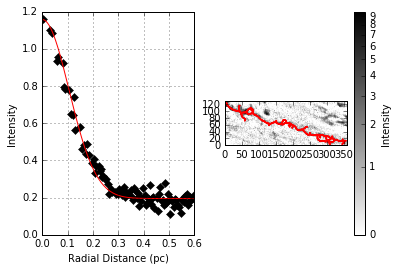

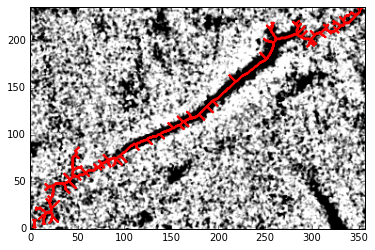

0 in 2
Fit Parameters: [ 0.95501302  0.02811776  0.2465001   0.        ] 
Fit Errors: [ 0.01934178  0.00557575  0.09312232  0.        ]
Fit Type: gaussian


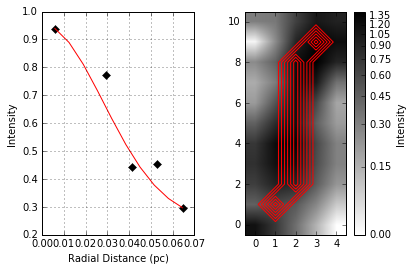

1 in 2
Fit Parameters: [ 1.10141972  0.10853389  0.28319641  0.22374218] 
Fit Errors: [ 0.00599982  0.00419718  0.01061167  0.01128991]
Fit Type: gaussian


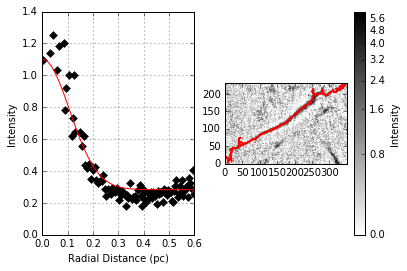

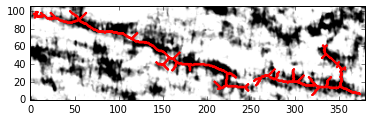

0 in 2
Fit Parameters: [ 2.68419     0.10307872  0.70532392  0.2089481 ] 
Fit Errors: [ 0.05574372  0.00908758  0.05090767  0.02485961]
Fit Type: gaussian


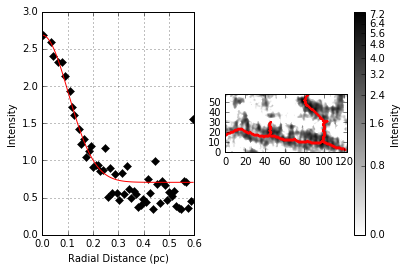

1 in 2
Fit Parameters: [ 3.25800047  0.09630351  1.00045773  0.19018036] 
Fit Errors: [ 0.03274557  0.00508192  0.03693333  0.01426987]
Fit Type: gaussian


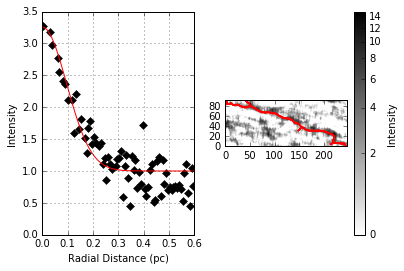

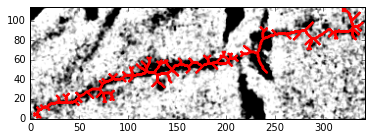

0 in 3
Fit Parameters: [ 1.32708162  0.09104914  0.20853104  0.17524206] 
Fit Errors: [ 0.00772446  0.00208172  0.0085914   0.00599758]
Fit Type: gaussian


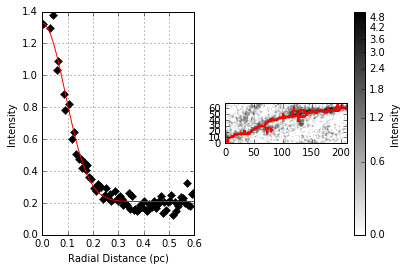

1 in 3
Fit Parameters: [ 1.21787192  0.10052252  0.20227584  0.20192411] 
Fit Errors: [ 0.01736517  0.00571063  0.02337197  0.01576429]
Fit Type: gaussian


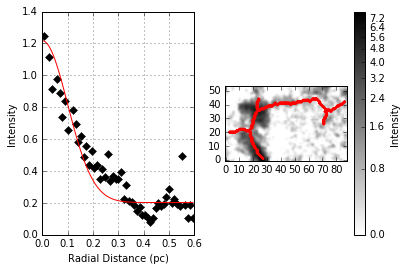

2 in 3
Fit Parameters: [ 0.655033    0.18637171  0.16867943  0.4211283 ] 
Fit Errors: [ 0.02929993  0.05102257  0.03475139  0.12521126]
Fit Type: gaussian


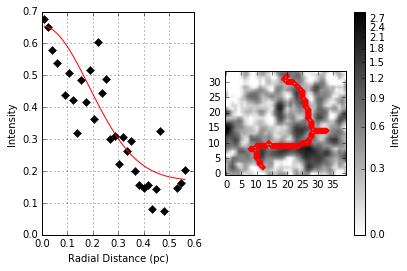

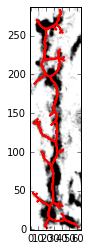

0 in 1
Fit Parameters: [ 2.36927065  0.08738822  0.48362228  0.16458259] 
Fit Errors: [ 0.1697903   0.02535248  0.07227086  0.07464574]
Fit Type: gaussian


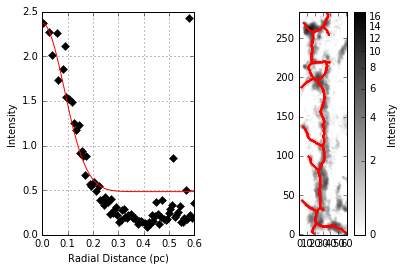

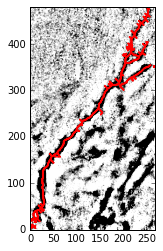

0 in 2
Fit Parameters: [   0.47643145    3.04831179 -287.44891988    7.17716273] 
Fit Errors: [  1.16444033e-02   3.62258030e+03   6.84098026e+05   8.53178812e+03]
Fit Type: gaussian


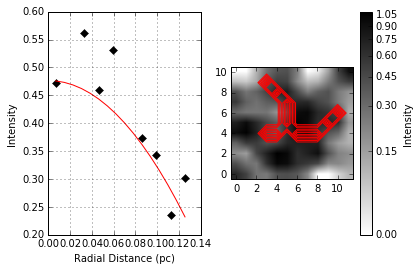

1 in 2
Fit Parameters: [ 2.1358532   0.09956956  0.15399945  0.1992887 ] 
Fit Errors: [ 0.0061254   0.00123457  0.00543809  0.00342038]
Fit Type: gaussian


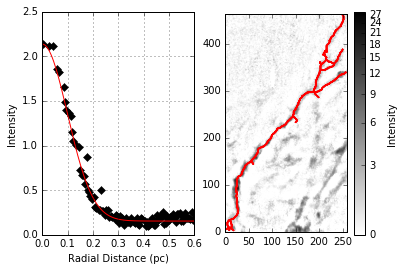

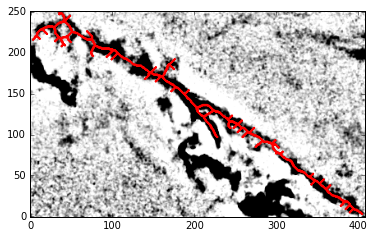

0 in 1
Fit Parameters: [ 2.41399218  0.1137564   0.18901531  0.23769314] 
Fit Errors: [ 0.01177302  0.00204065  0.01059182  0.00541556]
Fit Type: gaussian


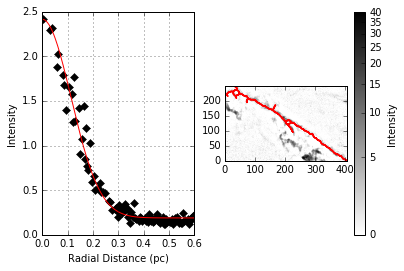

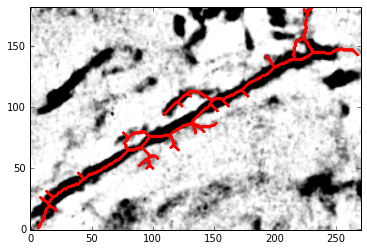

0 in 1
Fit Parameters: [ 9.41010084  0.0739833   0.33792367  0.12285052] 
Fit Errors: [ 0.02989628  0.0012162   0.03989765  0.0040614 ]
Fit Type: gaussian


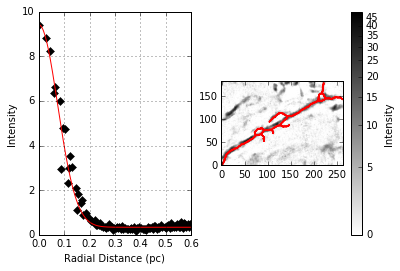

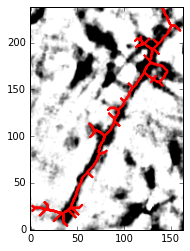

0 in 1
Fit Parameters: [ 5.1955496   0.10357732  0.5924153   0.2103109 ] 
Fit Errors: [ 0.0679794   0.00520136  0.03948543  0.01420479]
Fit Type: gaussian


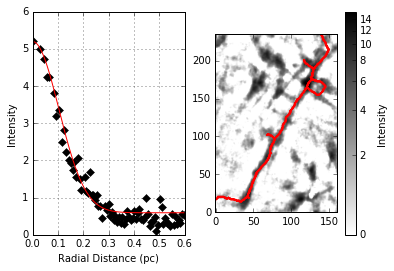

In [ ]:
for key in trees_all_sky_1_8:
    this_node = trees_all_sky_1_8[key]
    slice_files_list = []
    for i in range(this_node.length):
        slice_file_name = glob.glob(DATA_SLICE_BASE_DIR + '*{0}*'.format(str(this_node.root_v_slice + i)))[0]
        slice_files_list.append(slice_file_name)

    this_structure_cube = []
    for f in slice_files_list:
        full_slice, hdr = fits.getdata(f, header=True)
        corners = this_node.root_node.corners
        structure_slice = full_slice[corners[0][1]:corners[1][1], corners[0][0]:corners[1][0]]
        this_structure_cube.append(structure_slice)

    this_moment_map = create_0th_moment_map(this_structure_cube)

    fils = filfind.fil_finder_2D(this_moment_map, header=hdr, beamwidth=10.0, glob_thresh=20,
                                 distance=100, flatten_thresh=95, standard_width=0.5,
                                 size_thresh=600, mask=this_node.root_node.mask)
    fils.medskel(verbose=True)
    fils.analyze_skeletons(skel_thresh=1000.0, branch_thresh=50)
    fils.exec_rht()
    fils.find_widths(verbose=True, try_nonparam=False, auto_cut=False, max_distance=0.6)

13922_1031_0


### Width direction sanity check

In [19]:
maxslice = 0
minslice = np.inf
for k in trees_all_sky_1_8:
    this_tree = trees_all_sky_1_8[k]
    end_slice_max = this_tree.root_v_slice + this_tree.length
    end_slice_min = this_tree.root_v_slice - this_tree.length
    maxslice = end_slice_max if end_slice_max > maxslice else maxslice
    minslice = end_slice_min if end_slice_min < minslice else minslice
print(minslice, maxslice) # directions seems correct since we're using channels [955, 1092]

(943, 1089)
